In [1]:
from torchvision.transforms import Normalize, ToTensor, Resize, Compose, RandomAffine
from torchvision.datasets import ImageFolder
from efficientnet_pytorch import EfficientNet
from PIL import Image
from glob import glob
import numpy as np
import cv2
import pandas as pd
from torch import nn
import torch
import os
import torch.functional as F
from glob import glob
from tqdm import tqdm
from IPython.display import display
from torch.utils.data import DataLoader

from model import SignModel
from data import get_preprocessing
from utils import t2np, np_softmax, unnormalize, get_label_examples


val_transform = get_preprocessing(train=False)
valset = ImageFolder('classification_data/val/', transform=val_transform)
valloader = DataLoader(valset, batch_size=100, shuffle=False, num_workers=10)

model = SignModel(n_classes=len(valset.classes)).half().to('cuda').eval()

checkpoint = torch.load(os.path.join('class_ckpts', 'init', '4_ckpt.pth'))
model.load_state_dict(checkpoint[0])

id2class = valset.classes

Loaded pretrained weights for efficientnet-b4


In [2]:
errors = []
gt, preds = [], []
for x, y in valloader:
    x = x.half().to('cuda')
    y = t2np(y)
    y_hat = model(x)
    probs = np_softmax(t2np(y_hat))

    amax = np.argmax(probs, -1)
    scores = probs.max(-1)
    preds_ = np.array([id2class[x] for x in amax])
    labels = list(map(lambda x: id2class[x], y))
    
    for t, label, pred, score in zip(x, labels, preds_, scores):
        if label != pred:
            errors.append({
                'image': Image.fromarray(unnormalize(t)),
                'true_label': label,
                'prediction': pred,
                'score': score
            })
    gt.extend(y)
    preds.extend(amax)

In [7]:
from sklearn.metrics import classification_report
report = classification_report(gt, preds, target_names=valset.classes, output_dict=True)
accuracy = report['accuracy']
report = {k:v for k, v in report.items() if k not in ('accuracy', 'macro avg', 'weighted avg')}
report = sorted([(k, v) for k, v in report.items()], key=lambda x: x[1]['f1-score'])

print('{:^7} | {:^9} | {:^9} | {:^9} | {:^7}'.format('class', 'precision', 'recall', 'f1-score', 'count_val'))
for k, v in report:
    if v['f1-score'] >= .999:
        break
    else:
        print('{:^7} | {:^9.3f} | {:^9.3f} | {:^9.3f} | {:^7d}'.format(k, v['precision'], v['recall'], v['f1-score'], v['support']))

 class  | precision |  recall   | f1-score  | count_val
  2.2   |   0.000   |   0.000   |   0.000   |    3   
 6.11   |   0.000   |   0.000   |   0.000   |    1   
  8.7   |   0.000   |   0.000   |   0.000   |    1   
   8    |   0.333   |   0.200   |   0.250   |    5   
  4.3   |   0.750   |   0.158   |   0.261   |   19   
  1.1   |   0.750   |   0.333   |   0.462   |    9   
  6.4   |   0.333   |   0.800   |   0.471   |    5   
  8.1   |   0.556   |   0.455   |   0.500   |   11   
  8.5   |   0.875   |   0.467   |   0.609   |   15   
 3.13   |   1.000   |   0.444   |   0.615   |    9   
 5.24   |   0.714   |   0.556   |   0.625   |    9   
 6.10   |   0.672   |   0.596   |   0.632   |   151  
 8.23   |   0.889   |   0.500   |   0.640   |   16   
 1.17   |   1.000   |   0.500   |   0.667   |    4   
  3.3   |   1.000   |   0.500   |   0.667   |    2   
 5.31   |   1.000   |   0.500   |   0.667   |    2   
 6.16   |   0.783   |   0.581   |   0.667   |   31   
 8.17   |   1.000   |   0.

true_label=1.34, prediction=other, score=1.0


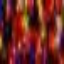

there are 559 examples for "1.34" class. Here some of them:


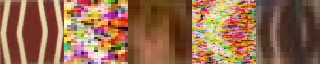

there are 133191 examples for "other" class. Here some of them:


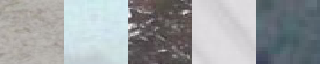

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=1.0


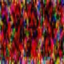

there are 559 examples for "1.34" class. Here some of them:


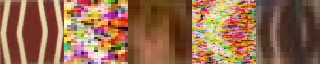

there are 133191 examples for "other" class. Here some of them:


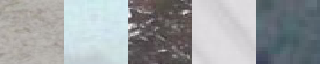

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=3.1, score=1.0


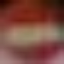

there are 12902 examples for "2.1" class. Here some of them:


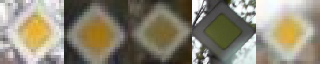

there are 1900 examples for "3.1" class. Here some of them:


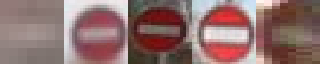

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=1.0


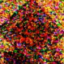

there are 12902 examples for "2.1" class. Here some of them:


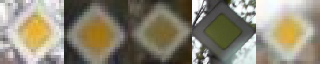

there are 133191 examples for "other" class. Here some of them:


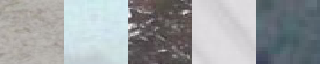

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=1.0


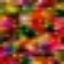

there are 12902 examples for "2.1" class. Here some of them:


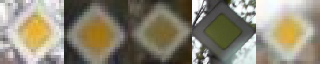

there are 133191 examples for "other" class. Here some of them:


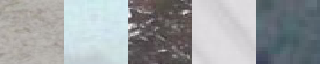

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=3.1, score=1.0


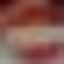

there are 12902 examples for "2.1" class. Here some of them:


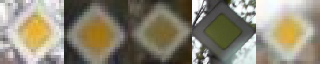

there are 1900 examples for "3.1" class. Here some of them:


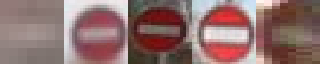

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.2, prediction=2.1, score=1.0


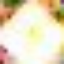

there are 677 examples for "2.2" class. Here some of them:


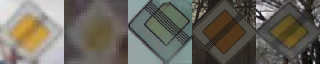

there are 12902 examples for "2.1" class. Here some of them:


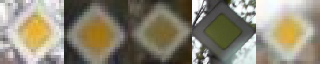

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=8.22, score=1.0


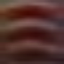

there are 3847 examples for "4.2" class. Here some of them:


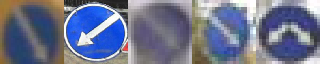

there are 689 examples for "8.22" class. Here some of them:


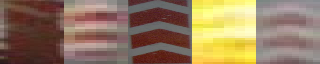

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=8.22, score=1.0


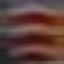

there are 3847 examples for "4.2" class. Here some of them:


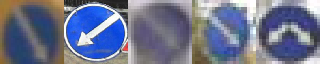

there are 689 examples for "8.22" class. Here some of them:


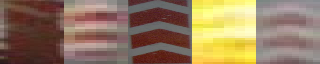

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=8.22, score=1.0


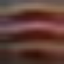

there are 3847 examples for "4.2" class. Here some of them:


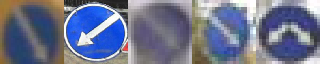

there are 689 examples for "8.22" class. Here some of them:


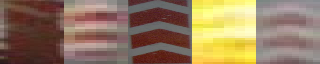

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=other, score=1.0


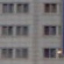

there are 6247 examples for "5.16" class. Here some of them:


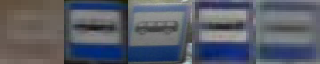

there are 133191 examples for "other" class. Here some of them:


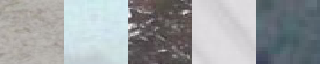

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=1.0


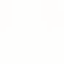

there are 30338 examples for "5.19" class. Here some of them:


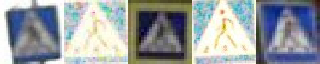

there are 133191 examples for "other" class. Here some of them:


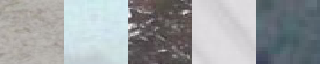

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=2.1, score=1.0


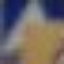

there are 3435 examples for "5.20" class. Here some of them:


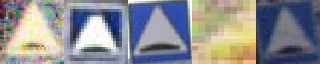

there are 12902 examples for "2.1" class. Here some of them:


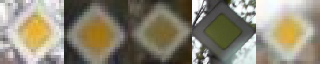

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=1.0


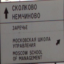

there are 1069 examples for "6.10" class. Here some of them:


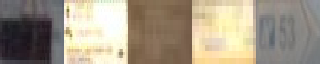

there are 851 examples for "6.9" class. Here some of them:


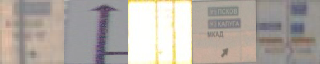

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=1.0


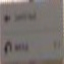

there are 1069 examples for "6.10" class. Here some of them:


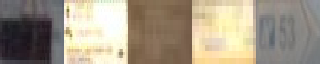

there are 851 examples for "6.9" class. Here some of them:


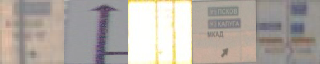

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=1.0


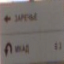

there are 1069 examples for "6.10" class. Here some of them:


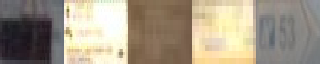

there are 851 examples for "6.9" class. Here some of them:


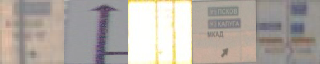

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=1.0


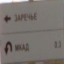

there are 1069 examples for "6.10" class. Here some of them:


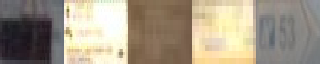

there are 851 examples for "6.9" class. Here some of them:


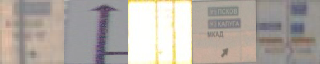

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=1.0


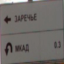

there are 1069 examples for "6.10" class. Here some of them:


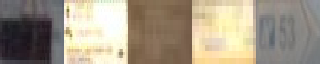

there are 851 examples for "6.9" class. Here some of them:


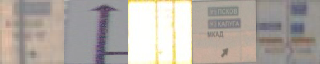

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=1.0


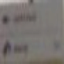

there are 1069 examples for "6.10" class. Here some of them:


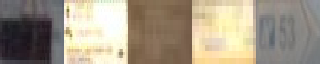

there are 851 examples for "6.9" class. Here some of them:


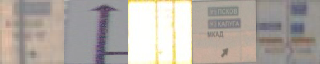

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=1.0


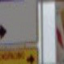

there are 1069 examples for "6.10" class. Here some of them:


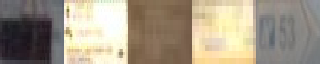

there are 133191 examples for "other" class. Here some of them:


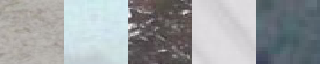

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=1.0


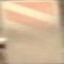

there are 689 examples for "8.22" class. Here some of them:


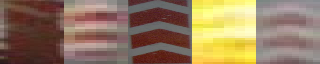

there are 133191 examples for "other" class. Here some of them:


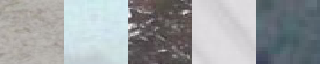

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=other, score=1.0


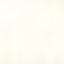

there are 303 examples for "8.5" class. Here some of them:


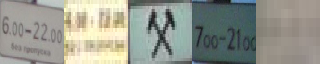

there are 133191 examples for "other" class. Here some of them:


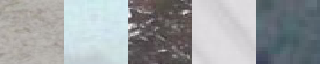

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9990234375


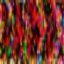

there are 559 examples for "1.34" class. Here some of them:


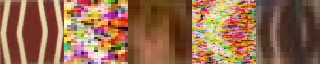

there are 133191 examples for "other" class. Here some of them:


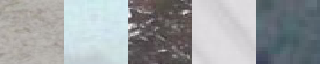

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=3.1, score=0.9990234375


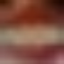

there are 12902 examples for "2.1" class. Here some of them:


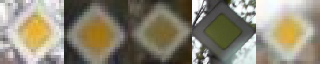

there are 1900 examples for "3.1" class. Here some of them:


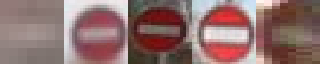

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.9990234375


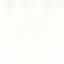

there are 30338 examples for "5.19" class. Here some of them:


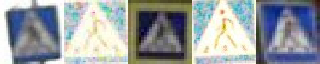

there are 133191 examples for "other" class. Here some of them:


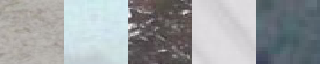

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9990234375


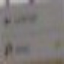

there are 1069 examples for "6.10" class. Here some of them:


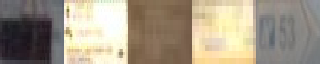

there are 851 examples for "6.9" class. Here some of them:


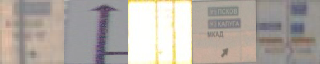

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9990234375


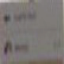

there are 1069 examples for "6.10" class. Here some of them:


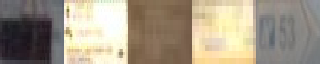

there are 851 examples for "6.9" class. Here some of them:


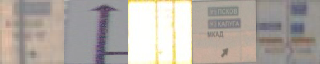

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=other, score=0.9990234375


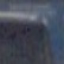

there are 851 examples for "6.9" class. Here some of them:


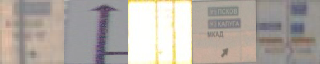

there are 133191 examples for "other" class. Here some of them:


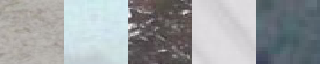

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.1, prediction=8.24, score=0.9990234375


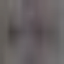

there are 362 examples for "8.1" class. Here some of them:


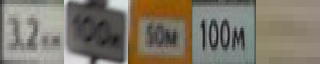

there are 335 examples for "8.24" class. Here some of them:


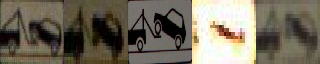

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.998046875


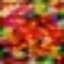

there are 12902 examples for "2.1" class. Here some of them:


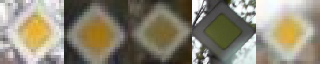

there are 133191 examples for "other" class. Here some of them:


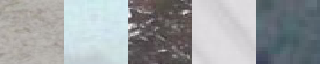

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.13, prediction=3.24, score=0.998046875


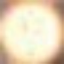

there are 368 examples for "3.13" class. Here some of them:


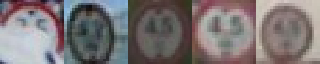

there are 5646 examples for "3.24" class. Here some of them:


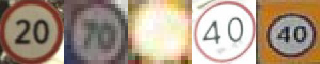

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.24, prediction=6.10, score=0.998046875


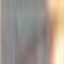

there are 143 examples for "5.24" class. Here some of them:


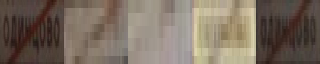

there are 1069 examples for "6.10" class. Here some of them:


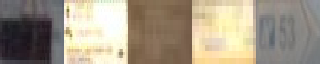

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.998046875


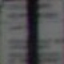

there are 1069 examples for "6.10" class. Here some of them:


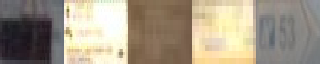

there are 133191 examples for "other" class. Here some of them:


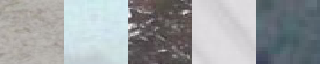

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.998046875


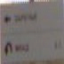

there are 1069 examples for "6.10" class. Here some of them:


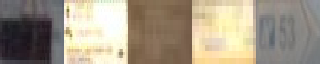

there are 851 examples for "6.9" class. Here some of them:


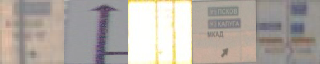

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.20, prediction=2.3, score=0.9970703125


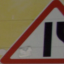

there are 615 examples for "1.20" class. Here some of them:


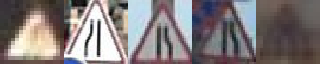

there are 1996 examples for "2.3" class. Here some of them:


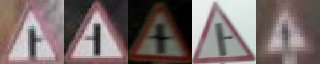

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.24, prediction=3.11, score=0.9970703125


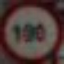

there are 5646 examples for "3.24" class. Here some of them:


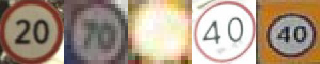

there are 90 examples for "3.11" class. Here some of them:


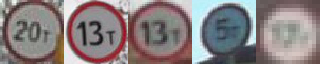

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=other, score=0.9970703125


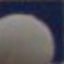

there are 1144 examples for "5.5" class. Here some of them:


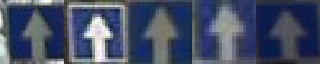

there are 133191 examples for "other" class. Here some of them:


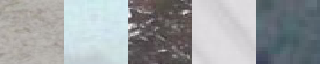

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.9970703125


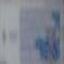

there are 851 examples for "6.9" class. Here some of them:


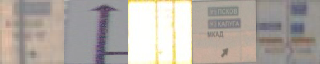

there are 1069 examples for "6.10" class. Here some of them:


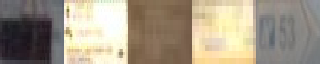

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.99609375


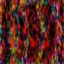

there are 559 examples for "1.34" class. Here some of them:


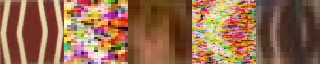

there are 133191 examples for "other" class. Here some of them:


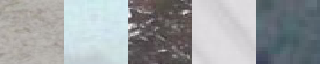

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.99609375


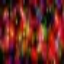

there are 559 examples for "1.34" class. Here some of them:


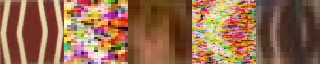

there are 133191 examples for "other" class. Here some of them:


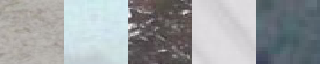

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.2, prediction=2.1, score=0.99609375


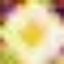

there are 677 examples for "2.2" class. Here some of them:


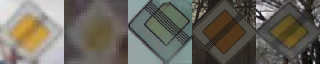

there are 12902 examples for "2.1" class. Here some of them:


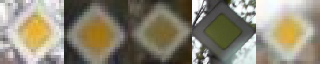

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.99609375


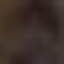

there are 3847 examples for "4.2" class. Here some of them:


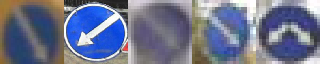

there are 30338 examples for "5.19" class. Here some of them:


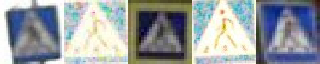

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=8.22, score=0.99609375


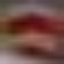

there are 3847 examples for "4.2" class. Here some of them:


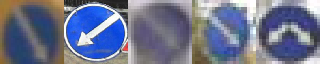

there are 689 examples for "8.22" class. Here some of them:


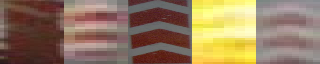

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.99609375


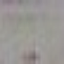

there are 1069 examples for "6.10" class. Here some of them:


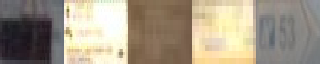

there are 133191 examples for "other" class. Here some of them:


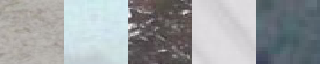

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.9951171875


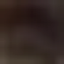

there are 3847 examples for "4.2" class. Here some of them:


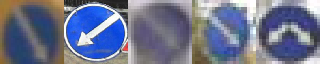

there are 30338 examples for "5.19" class. Here some of them:


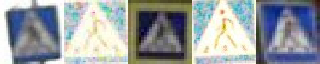

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.9951171875


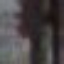

there are 1069 examples for "6.10" class. Here some of them:


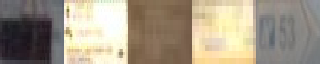

there are 133191 examples for "other" class. Here some of them:


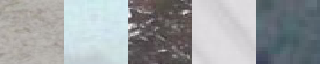

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.9951171875


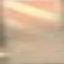

there are 689 examples for "8.22" class. Here some of them:


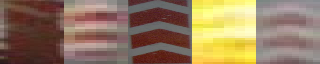

there are 133191 examples for "other" class. Here some of them:


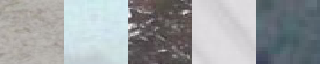

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.994140625


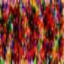

there are 559 examples for "1.34" class. Here some of them:


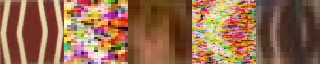

there are 133191 examples for "other" class. Here some of them:


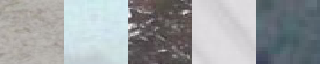

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.3, prediction=1.11, score=0.994140625


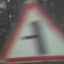

there are 1996 examples for "2.3" class. Here some of them:


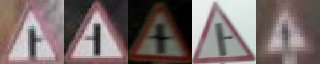

there are 1021 examples for "1.11" class. Here some of them:


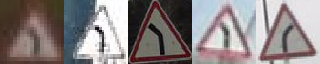

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.994140625


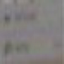

there are 1069 examples for "6.10" class. Here some of them:


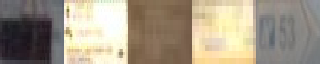

there are 851 examples for "6.9" class. Here some of them:


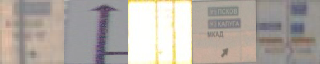

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.994140625


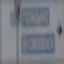

there are 851 examples for "6.9" class. Here some of them:


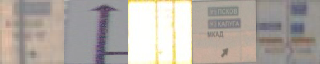

there are 1069 examples for "6.10" class. Here some of them:


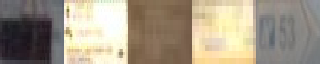

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9931640625


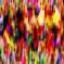

there are 559 examples for "1.34" class. Here some of them:


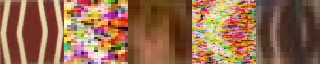

there are 133191 examples for "other" class. Here some of them:


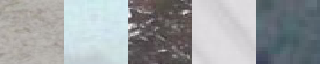

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=5.19, score=0.9931640625


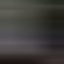

there are 559 examples for "1.34" class. Here some of them:


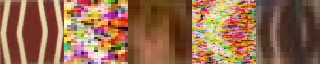

there are 30338 examples for "5.19" class. Here some of them:


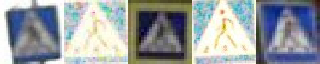

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.9931640625


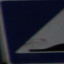

there are 3435 examples for "5.20" class. Here some of them:


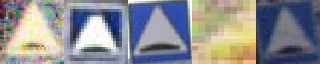

there are 30338 examples for "5.19" class. Here some of them:


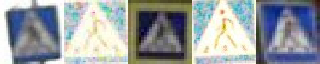

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.9931640625


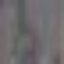

there are 61 examples for "8.17" class. Here some of them:


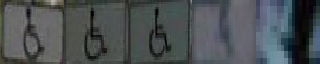

there are 133191 examples for "other" class. Here some of them:


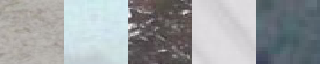

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=other, score=0.9931640625


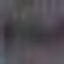

there are 2135 examples for "8.2" class. Here some of them:


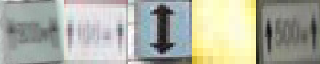

there are 133191 examples for "other" class. Here some of them:


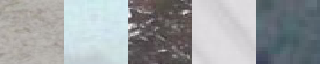

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.9931640625


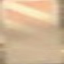

there are 689 examples for "8.22" class. Here some of them:


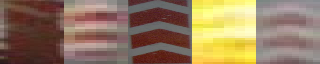

there are 133191 examples for "other" class. Here some of them:


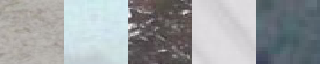

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.9912109375


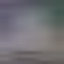

there are 3435 examples for "5.20" class. Here some of them:


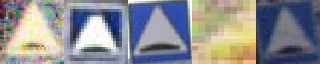

there are 30338 examples for "5.19" class. Here some of them:


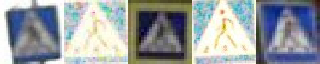

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.9912109375


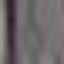

there are 61 examples for "8.17" class. Here some of them:


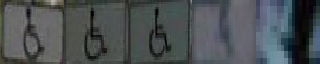

there are 133191 examples for "other" class. Here some of them:


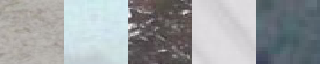

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.990234375


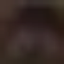

there are 3847 examples for "4.2" class. Here some of them:


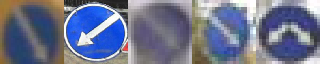

there are 30338 examples for "5.19" class. Here some of them:


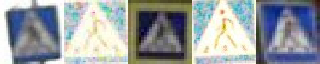

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.990234375


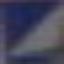

there are 3435 examples for "5.20" class. Here some of them:


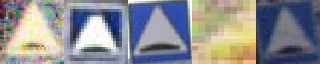

there are 30338 examples for "5.19" class. Here some of them:


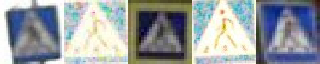

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=8.22, score=0.990234375


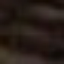

there are 133191 examples for "other" class. Here some of them:


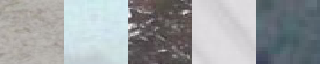

there are 689 examples for "8.22" class. Here some of them:


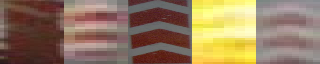

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=5.19, score=0.990234375


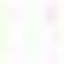

there are 133191 examples for "other" class. Here some of them:


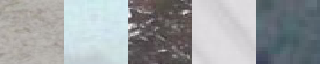

there are 30338 examples for "5.19" class. Here some of them:


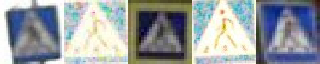

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9892578125


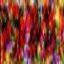

there are 559 examples for "1.34" class. Here some of them:


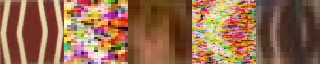

there are 133191 examples for "other" class. Here some of them:


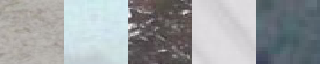

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9892578125


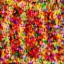

there are 559 examples for "1.34" class. Here some of them:


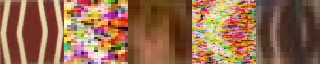

there are 133191 examples for "other" class. Here some of them:


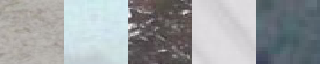

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.9892578125


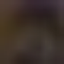

there are 3847 examples for "4.2" class. Here some of them:


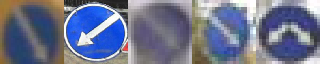

there are 30338 examples for "5.19" class. Here some of them:


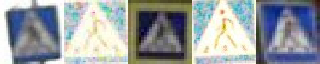

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.9892578125


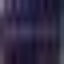

there are 403 examples for "5.7" class. Here some of them:


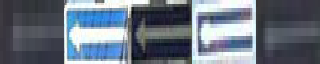

there are 1069 examples for "6.10" class. Here some of them:


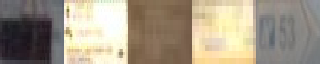

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.98828125


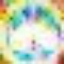

there are 3847 examples for "4.2" class. Here some of them:


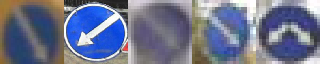

there are 416 examples for "4.4" class. Here some of them:


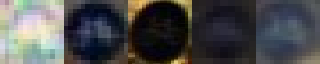

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=other, score=0.98828125


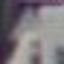

there are 1144 examples for "5.5" class. Here some of them:


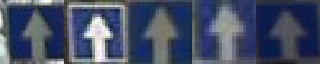

there are 133191 examples for "other" class. Here some of them:


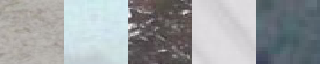

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=4.1, score=0.9873046875


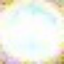

there are 416 examples for "4.4" class. Here some of them:


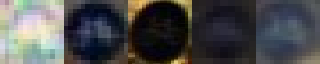

there are 5770 examples for "4.1" class. Here some of them:


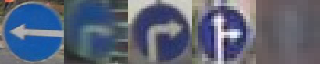

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.9873046875


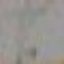

there are 1069 examples for "6.10" class. Here some of them:


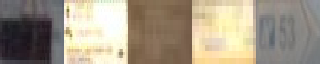

there are 133191 examples for "other" class. Here some of them:


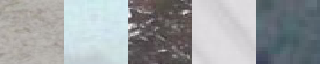

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.986328125


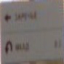

there are 1069 examples for "6.10" class. Here some of them:


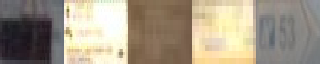

there are 851 examples for "6.9" class. Here some of them:


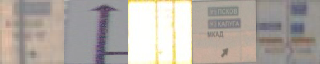

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.984375


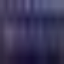

there are 403 examples for "5.7" class. Here some of them:


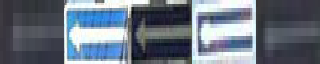

there are 1069 examples for "6.10" class. Here some of them:


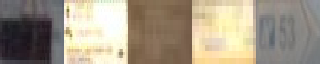

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.10, score=0.984375


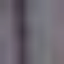

there are 61 examples for "8.17" class. Here some of them:


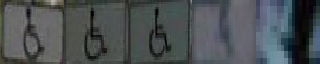

there are 1069 examples for "6.10" class. Here some of them:


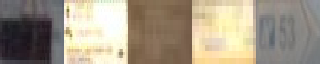

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.98388671875


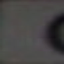

there are 1384 examples for "6.16" class. Here some of them:


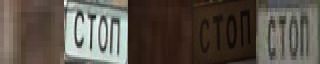

there are 133191 examples for "other" class. Here some of them:


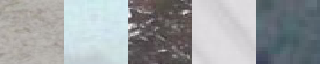

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.98388671875


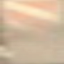

there are 689 examples for "8.22" class. Here some of them:


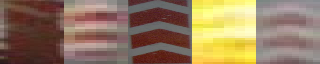

there are 133191 examples for "other" class. Here some of them:


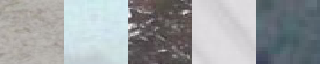

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.98291015625


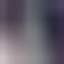

there are 3435 examples for "5.20" class. Here some of them:


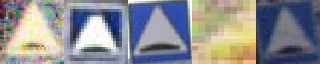

there are 30338 examples for "5.19" class. Here some of them:


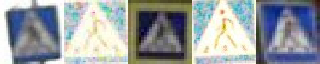

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.98291015625


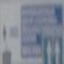

there are 851 examples for "6.9" class. Here some of them:


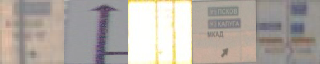

there are 1069 examples for "6.10" class. Here some of them:


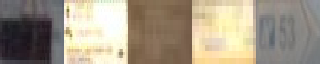

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.98193359375


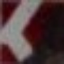

there are 559 examples for "1.34" class. Here some of them:


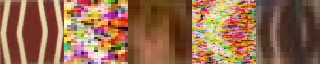

there are 133191 examples for "other" class. Here some of them:


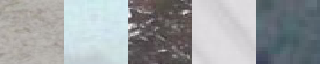

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8, prediction=other, score=0.98193359375


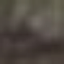

there are 98 examples for "8" class. Here some of them:


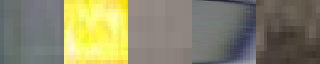

there are 133191 examples for "other" class. Here some of them:


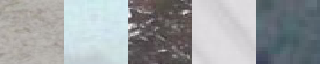

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=4.1, score=0.98095703125


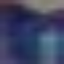

there are 133 examples for "5.3" class. Here some of them:


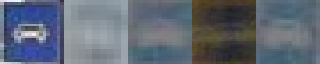

there are 5770 examples for "4.1" class. Here some of them:


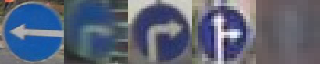

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.1, prediction=8.2, score=0.98095703125


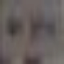

there are 362 examples for "8.1" class. Here some of them:


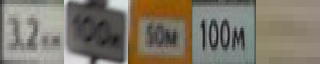

there are 2135 examples for "8.2" class. Here some of them:


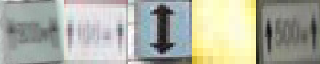

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.27, score=0.97998046875


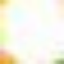

there are 225 examples for "4.3" class. Here some of them:


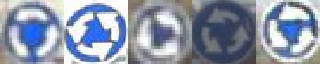

there are 4689 examples for "3.27" class. Here some of them:


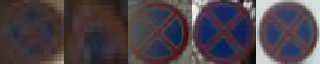

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.97998046875


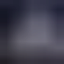

there are 3435 examples for "5.20" class. Here some of them:


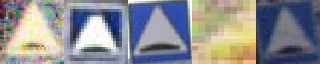

there are 30338 examples for "5.19" class. Here some of them:


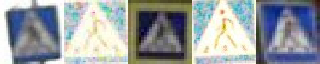

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.27, score=0.97900390625


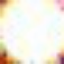

there are 225 examples for "4.3" class. Here some of them:


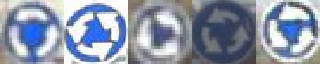

there are 4689 examples for "3.27" class. Here some of them:


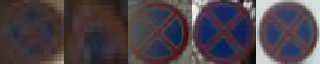

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.97802734375


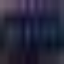

there are 403 examples for "5.7" class. Here some of them:


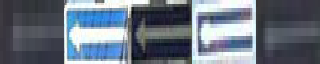

there are 1069 examples for "6.10" class. Here some of them:


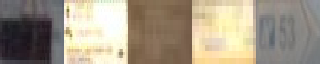

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.97705078125


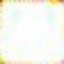

there are 30338 examples for "5.19" class. Here some of them:


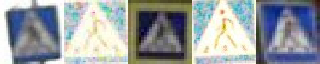

there are 3435 examples for "5.20" class. Here some of them:


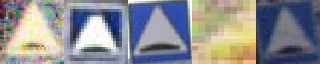

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=8.6, score=0.97705078125


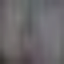

there are 61 examples for "8.17" class. Here some of them:


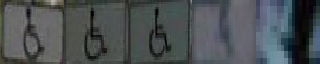

there are 130 examples for "8.6" class. Here some of them:


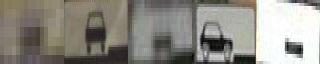

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.97607421875


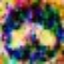

there are 3847 examples for "4.2" class. Here some of them:


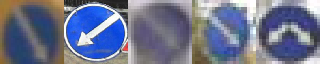

there are 416 examples for "4.4" class. Here some of them:


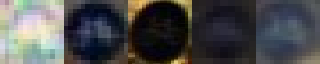

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.23, prediction=8.1, score=0.97509765625


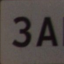

there are 144 examples for "5.23" class. Here some of them:


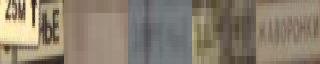

there are 362 examples for "8.1" class. Here some of them:


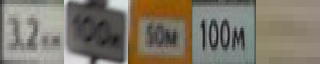

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.97509765625


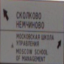

there are 1069 examples for "6.10" class. Here some of them:


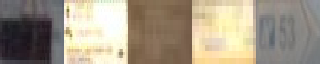

there are 851 examples for "6.9" class. Here some of them:


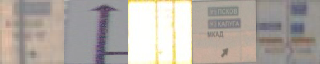

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.97412109375


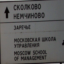

there are 1069 examples for "6.10" class. Here some of them:


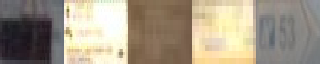

there are 851 examples for "6.9" class. Here some of them:


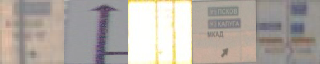

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.7, prediction=other, score=0.97412109375


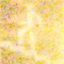

there are 226 examples for "6.7" class. Here some of them:


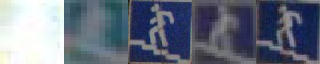

there are 133191 examples for "other" class. Here some of them:


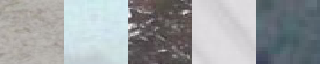

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.97314453125


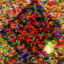

there are 12902 examples for "2.1" class. Here some of them:


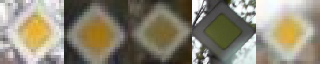

there are 133191 examples for "other" class. Here some of them:


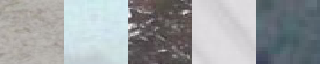

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.97314453125


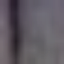

there are 61 examples for "8.17" class. Here some of them:


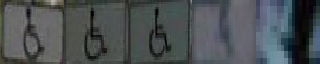

there are 133191 examples for "other" class. Here some of them:


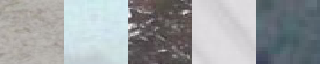

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9716796875


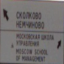

there are 1069 examples for "6.10" class. Here some of them:


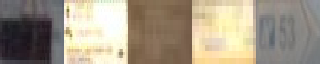

there are 851 examples for "6.9" class. Here some of them:


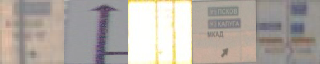

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.1, score=0.970703125


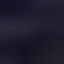

there are 3847 examples for "4.2" class. Here some of them:


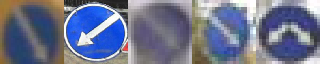

there are 5770 examples for "4.1" class. Here some of them:


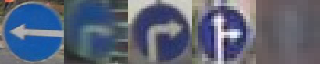

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.970703125


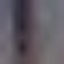

there are 61 examples for "8.17" class. Here some of them:


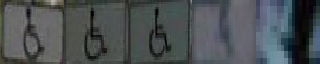

there are 133191 examples for "other" class. Here some of them:


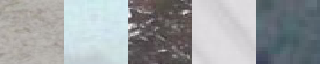

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9697265625


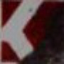

there are 559 examples for "1.34" class. Here some of them:


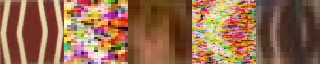

there are 133191 examples for "other" class. Here some of them:


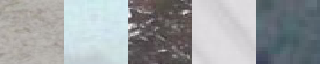

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9697265625


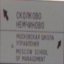

there are 1069 examples for "6.10" class. Here some of them:


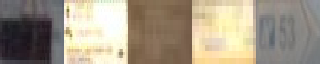

there are 851 examples for "6.9" class. Here some of them:


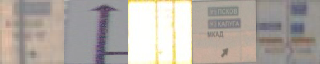

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.24, prediction=6.13, score=0.9677734375


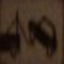

there are 335 examples for "8.24" class. Here some of them:


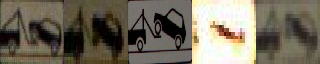

there are 110 examples for "6.13" class. Here some of them:


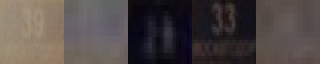

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.966796875


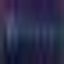

there are 403 examples for "5.7" class. Here some of them:


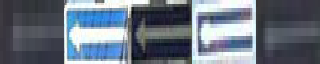

there are 1069 examples for "6.10" class. Here some of them:


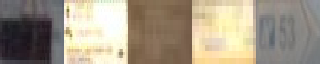

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=8.22, score=0.9658203125


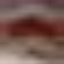

there are 3847 examples for "4.2" class. Here some of them:


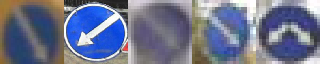

there are 689 examples for "8.22" class. Here some of them:


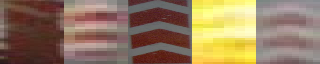

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=8.2, score=0.9658203125


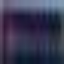

there are 403 examples for "5.7" class. Here some of them:


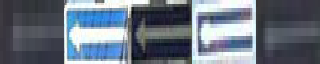

there are 2135 examples for "8.2" class. Here some of them:


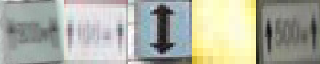

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.96533203125


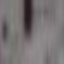

there are 1069 examples for "6.10" class. Here some of them:


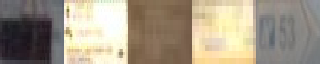

there are 133191 examples for "other" class. Here some of them:


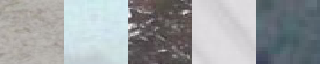

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.1, score=0.96435546875


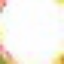

there are 225 examples for "4.3" class. Here some of them:


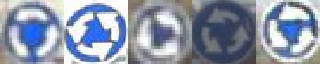

there are 5770 examples for "4.1" class. Here some of them:


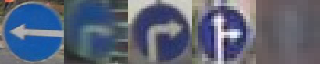

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.96337890625


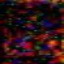

there are 30338 examples for "5.19" class. Here some of them:


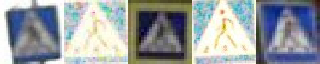

there are 133191 examples for "other" class. Here some of them:


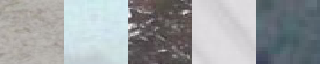

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.1, score=0.96240234375


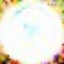

there are 225 examples for "4.3" class. Here some of them:


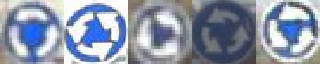

there are 5770 examples for "4.1" class. Here some of them:


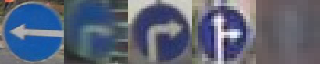

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=other, score=0.96044921875


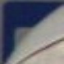

there are 6247 examples for "5.16" class. Here some of them:


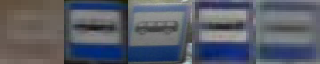

there are 133191 examples for "other" class. Here some of them:


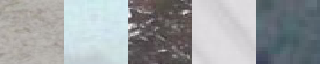

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.96044921875


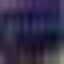

there are 403 examples for "5.7" class. Here some of them:


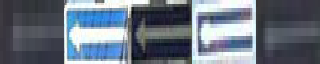

there are 1069 examples for "6.10" class. Here some of them:


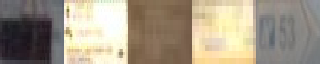

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.95947265625


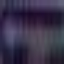

there are 403 examples for "5.7" class. Here some of them:


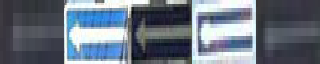

there are 1069 examples for "6.10" class. Here some of them:


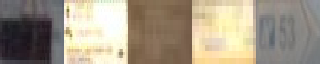

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.11, score=0.95947265625


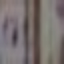

there are 1069 examples for "6.10" class. Here some of them:


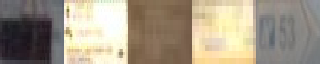

there are 37 examples for "6.11" class. Here some of them:


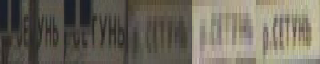

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=6.10, score=0.95947265625


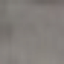

there are 133191 examples for "other" class. Here some of them:


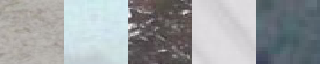

there are 1069 examples for "6.10" class. Here some of them:


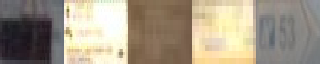

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.958984375


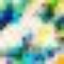

there are 3847 examples for "4.2" class. Here some of them:


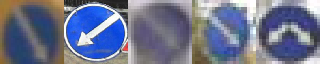

there are 416 examples for "4.4" class. Here some of them:


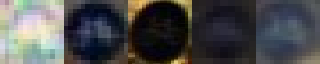

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.958984375


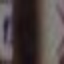

there are 1069 examples for "6.10" class. Here some of them:


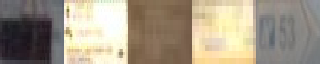

there are 133191 examples for "other" class. Here some of them:


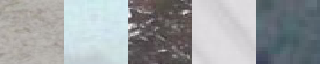

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=4.2, score=0.958984375


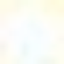

there are 133191 examples for "other" class. Here some of them:


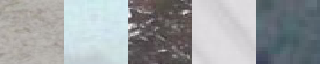

there are 3847 examples for "4.2" class. Here some of them:


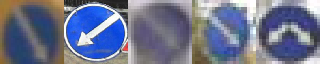

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=6.10, score=0.9580078125


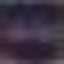

there are 50 examples for "5.4" class. Here some of them:


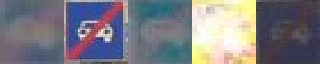

there are 1069 examples for "6.10" class. Here some of them:


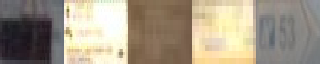

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9560546875


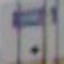

there are 1069 examples for "6.10" class. Here some of them:


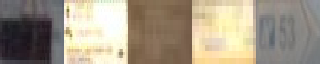

there are 851 examples for "6.9" class. Here some of them:


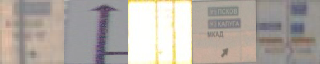

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=5.6, score=0.955078125


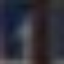

there are 1144 examples for "5.5" class. Here some of them:


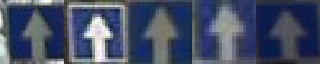

there are 677 examples for "5.6" class. Here some of them:


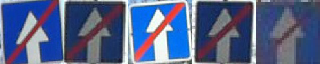

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.955078125


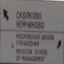

there are 1069 examples for "6.10" class. Here some of them:


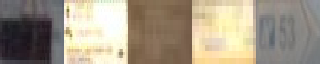

there are 851 examples for "6.9" class. Here some of them:


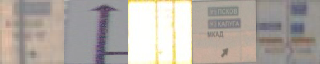

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.25, prediction=5.19, score=0.9541015625


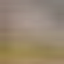

there are 1048 examples for "1.25" class. Here some of them:


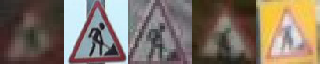

there are 30338 examples for "5.19" class. Here some of them:


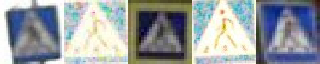

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=5.19, score=0.9541015625


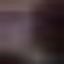

there are 559 examples for "1.34" class. Here some of them:


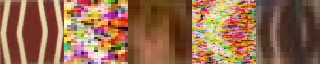

there are 30338 examples for "5.19" class. Here some of them:


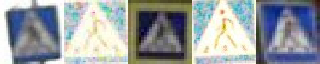

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.95361328125


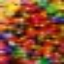

there are 12902 examples for "2.1" class. Here some of them:


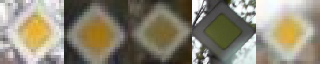

there are 133191 examples for "other" class. Here some of them:


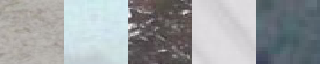

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.24, prediction=3.11, score=0.95263671875


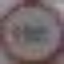

there are 5646 examples for "3.24" class. Here some of them:


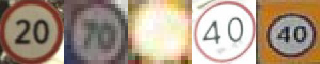

there are 90 examples for "3.11" class. Here some of them:


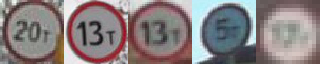

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.19, score=0.95263671875


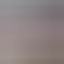

there are 1069 examples for "6.10" class. Here some of them:


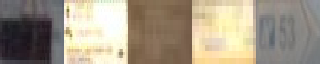

there are 30338 examples for "5.19" class. Here some of them:


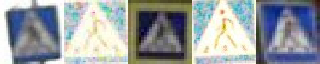

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.32, prediction=other, score=0.95166015625


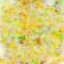

there are 109 examples for "3.32" class. Here some of them:


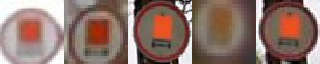

there are 133191 examples for "other" class. Here some of them:


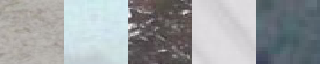

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=4.4, score=0.95166015625


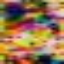

there are 30338 examples for "5.19" class. Here some of them:


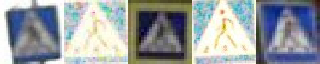

there are 416 examples for "4.4" class. Here some of them:


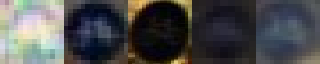

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.94921875


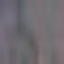

there are 61 examples for "8.17" class. Here some of them:


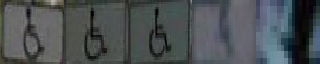

there are 133191 examples for "other" class. Here some of them:


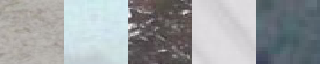

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.23, prediction=6.10, score=0.9482421875


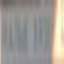

there are 144 examples for "5.23" class. Here some of them:


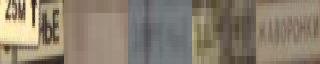

there are 1069 examples for "6.10" class. Here some of them:


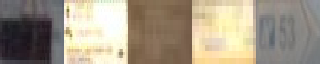

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.9482421875


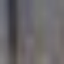

there are 61 examples for "8.17" class. Here some of them:


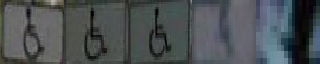

there are 133191 examples for "other" class. Here some of them:


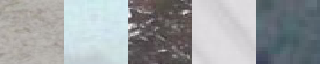

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.9462890625


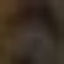

there are 3847 examples for "4.2" class. Here some of them:


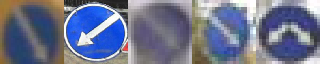

there are 30338 examples for "5.19" class. Here some of them:


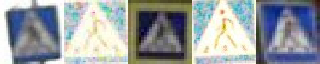

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.94384765625


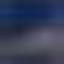

there are 30338 examples for "5.19" class. Here some of them:


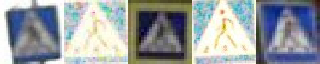

there are 3435 examples for "5.20" class. Here some of them:


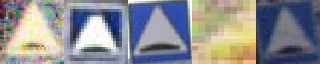

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.94384765625


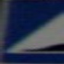

there are 3435 examples for "5.20" class. Here some of them:


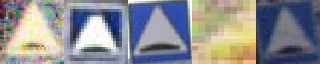

there are 30338 examples for "5.19" class. Here some of them:


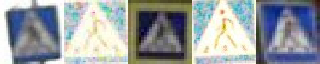

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=5.19, score=0.94384765625


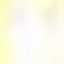

there are 133191 examples for "other" class. Here some of them:


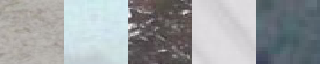

there are 30338 examples for "5.19" class. Here some of them:


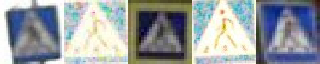

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.94287109375


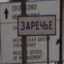

there are 1069 examples for "6.10" class. Here some of them:


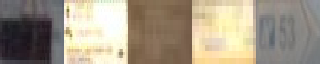

there are 851 examples for "6.9" class. Here some of them:


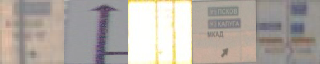

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.94287109375


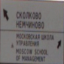

there are 1069 examples for "6.10" class. Here some of them:


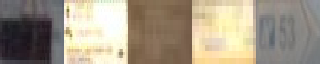

there are 851 examples for "6.9" class. Here some of them:


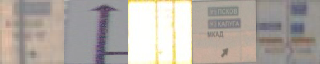

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.94140625


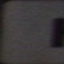

there are 1069 examples for "6.10" class. Here some of them:


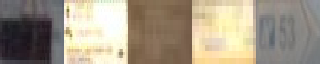

there are 133191 examples for "other" class. Here some of them:


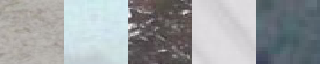

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.4, prediction=5.15, score=0.94140625


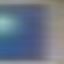

there are 1423 examples for "6.4" class. Here some of them:


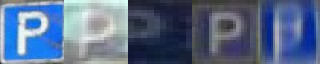

there are 12199 examples for "5.15" class. Here some of them:


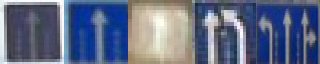

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.939453125


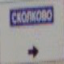

there are 1069 examples for "6.10" class. Here some of them:


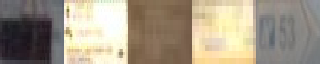

there are 851 examples for "6.9" class. Here some of them:


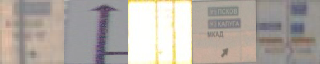

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.9375


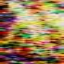

there are 30338 examples for "5.19" class. Here some of them:


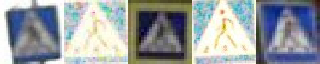

there are 133191 examples for "other" class. Here some of them:


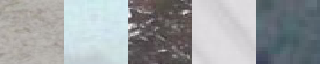

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9375


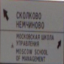

there are 1069 examples for "6.10" class. Here some of them:


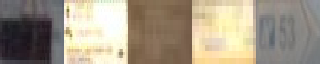

there are 851 examples for "6.9" class. Here some of them:


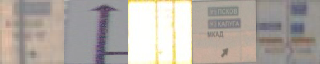

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=5.6, score=0.93701171875


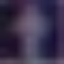

there are 1144 examples for "5.5" class. Here some of them:


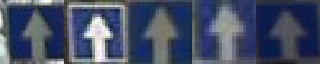

there are 677 examples for "5.6" class. Here some of them:


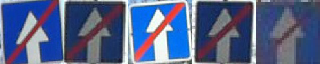

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=5.15, score=0.93701171875


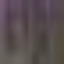

there are 1384 examples for "6.16" class. Here some of them:


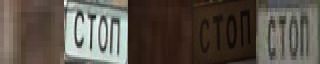

there are 12199 examples for "5.15" class. Here some of them:


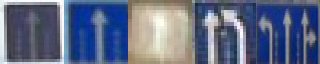

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.93603515625


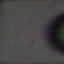

there are 1384 examples for "6.16" class. Here some of them:


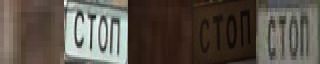

there are 133191 examples for "other" class. Here some of them:


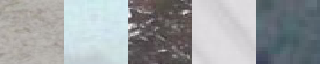

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=5.16, score=0.93505859375


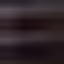

there are 689 examples for "8.22" class. Here some of them:


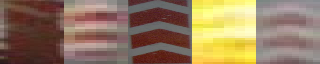

there are 6247 examples for "5.16" class. Here some of them:


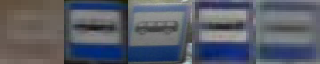

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=5.16, score=0.93408203125


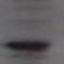

there are 133191 examples for "other" class. Here some of them:


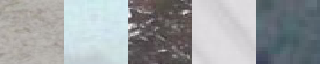

there are 6247 examples for "5.16" class. Here some of them:


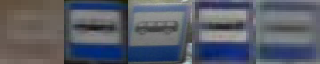

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=other, score=0.93359375


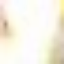

there are 5333 examples for "2.4" class. Here some of them:


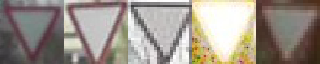

there are 133191 examples for "other" class. Here some of them:


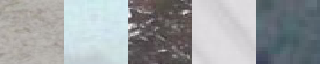

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.93359375


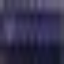

there are 403 examples for "5.7" class. Here some of them:


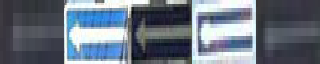

there are 1069 examples for "6.10" class. Here some of them:


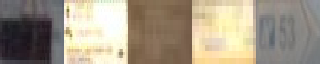

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9326171875


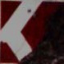

there are 559 examples for "1.34" class. Here some of them:


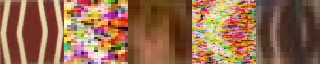

there are 133191 examples for "other" class. Here some of them:


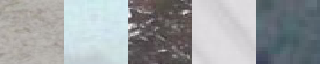

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=6.13, score=0.931640625


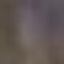

there are 3435 examples for "5.20" class. Here some of them:


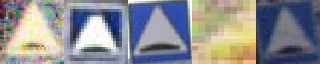

there are 110 examples for "6.13" class. Here some of them:


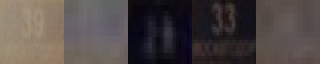

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=5.5, score=0.931640625


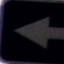

there are 403 examples for "5.7" class. Here some of them:


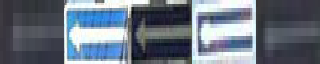

there are 1144 examples for "5.5" class. Here some of them:


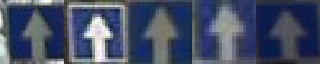

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.93017578125


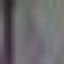

there are 61 examples for "8.17" class. Here some of them:


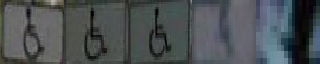

there are 133191 examples for "other" class. Here some of them:


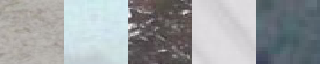

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=2.1, score=0.92919921875


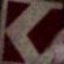

there are 559 examples for "1.34" class. Here some of them:


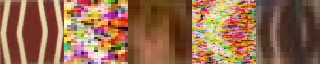

there are 12902 examples for "2.1" class. Here some of them:


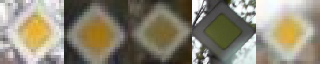

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=5.19, score=0.92822265625


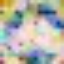

there are 416 examples for "4.4" class. Here some of them:


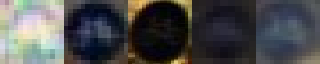

there are 30338 examples for "5.19" class. Here some of them:


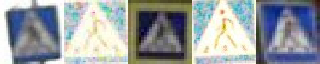

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.1, score=0.92578125


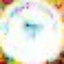

there are 225 examples for "4.3" class. Here some of them:


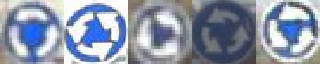

there are 5770 examples for "4.1" class. Here some of them:


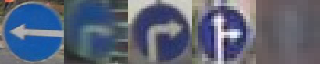

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.9248046875


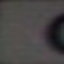

there are 1384 examples for "6.16" class. Here some of them:


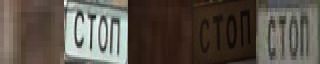

there are 133191 examples for "other" class. Here some of them:


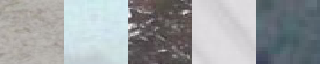

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.92333984375


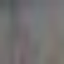

there are 61 examples for "8.17" class. Here some of them:


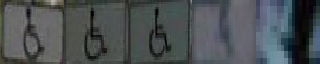

there are 133191 examples for "other" class. Here some of them:


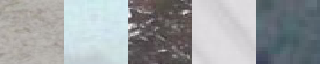

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=4.4, score=0.9208984375


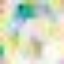

there are 5770 examples for "4.1" class. Here some of them:


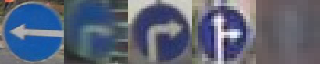

there are 416 examples for "4.4" class. Here some of them:


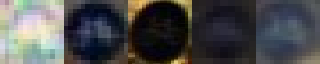

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.919921875


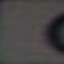

there are 1384 examples for "6.16" class. Here some of them:


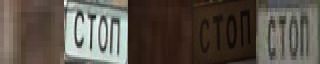

there are 133191 examples for "other" class. Here some of them:


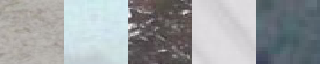

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.91650390625


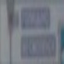

there are 851 examples for "6.9" class. Here some of them:


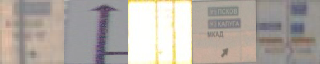

there are 1069 examples for "6.10" class. Here some of them:


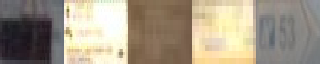

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.916015625


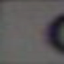

there are 1384 examples for "6.16" class. Here some of them:


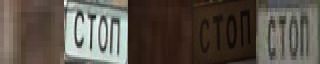

there are 133191 examples for "other" class. Here some of them:


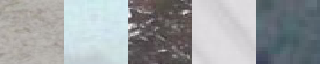

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.13, prediction=3.24, score=0.9140625


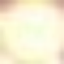

there are 368 examples for "3.13" class. Here some of them:


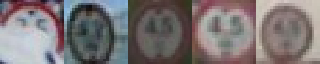

there are 5646 examples for "3.24" class. Here some of them:


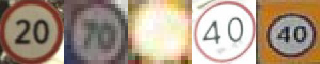

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.9140625


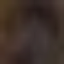

there are 3847 examples for "4.2" class. Here some of them:


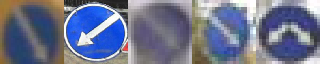

there are 30338 examples for "5.19" class. Here some of them:


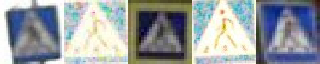

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=5.5, score=0.9140625


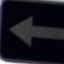

there are 403 examples for "5.7" class. Here some of them:


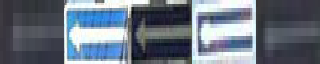

there are 1144 examples for "5.5" class. Here some of them:


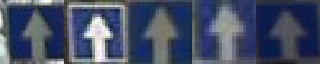

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=5.15, score=0.91357421875


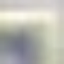

there are 6247 examples for "5.16" class. Here some of them:


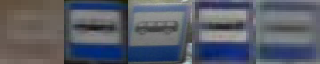

there are 12199 examples for "5.15" class. Here some of them:


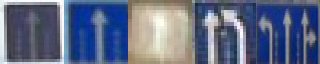

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.91357421875


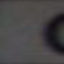

there are 1384 examples for "6.16" class. Here some of them:


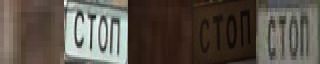

there are 133191 examples for "other" class. Here some of them:


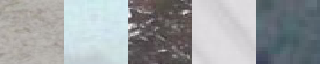

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.90771484375


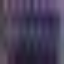

there are 403 examples for "5.7" class. Here some of them:


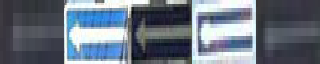

there are 1069 examples for "6.10" class. Here some of them:


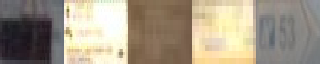

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=5.16, score=0.90771484375


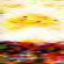

there are 689 examples for "8.22" class. Here some of them:


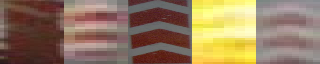

there are 6247 examples for "5.16" class. Here some of them:


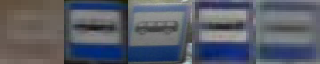

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=5.19, score=0.9072265625


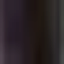

there are 1144 examples for "5.5" class. Here some of them:


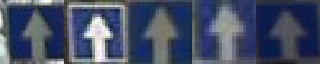

there are 30338 examples for "5.19" class. Here some of them:


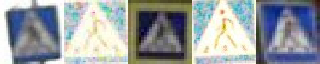

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.9072265625


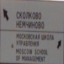

there are 1069 examples for "6.10" class. Here some of them:


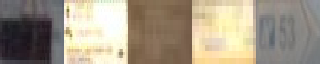

there are 851 examples for "6.9" class. Here some of them:


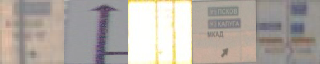

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.9013671875


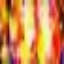

there are 559 examples for "1.34" class. Here some of them:


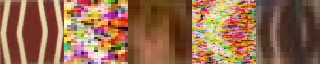

there are 133191 examples for "other" class. Here some of them:


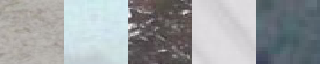

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.9013671875


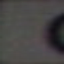

there are 1384 examples for "6.16" class. Here some of them:


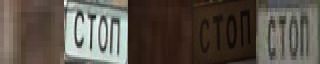

there are 133191 examples for "other" class. Here some of them:


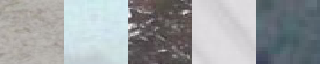

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.89892578125


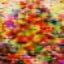

there are 12902 examples for "2.1" class. Here some of them:


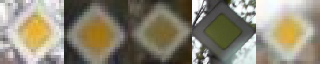

there are 133191 examples for "other" class. Here some of them:


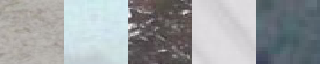

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.8974609375


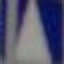

there are 3435 examples for "5.20" class. Here some of them:


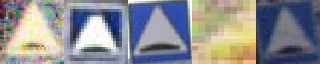

there are 30338 examples for "5.19" class. Here some of them:


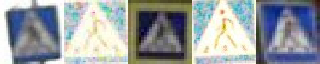

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.1, prediction=8.2, score=0.89453125


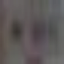

there are 362 examples for "8.1" class. Here some of them:


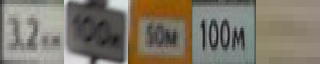

there are 2135 examples for "8.2" class. Here some of them:


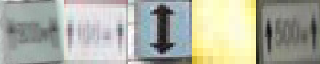

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.1, prediction=1.12, score=0.892578125


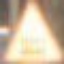

there are 208 examples for "1.1" class. Here some of them:


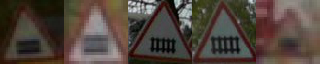

there are 391 examples for "1.12" class. Here some of them:


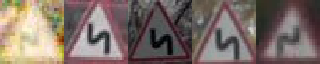

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=6.16, score=0.892578125


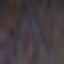

there are 133191 examples for "other" class. Here some of them:


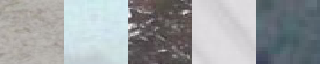

there are 1384 examples for "6.16" class. Here some of them:


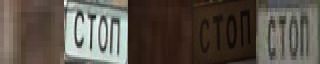

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.8896484375


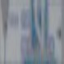

there are 851 examples for "6.9" class. Here some of them:


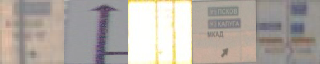

there are 1069 examples for "6.10" class. Here some of them:


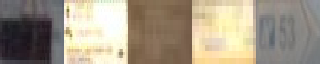

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.12, prediction=5.20, score=0.888671875


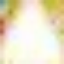

there are 391 examples for "1.12" class. Here some of them:


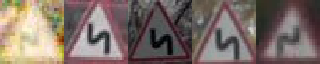

there are 3435 examples for "5.20" class. Here some of them:


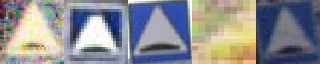

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.88818359375


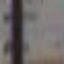

there are 1069 examples for "6.10" class. Here some of them:


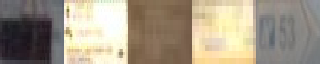

there are 851 examples for "6.9" class. Here some of them:


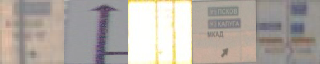

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=1.12, score=0.88671875


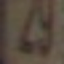

there are 133191 examples for "other" class. Here some of them:


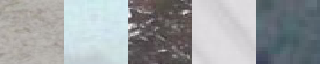

there are 391 examples for "1.12" class. Here some of them:


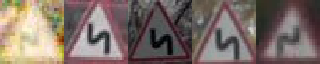

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.88330078125


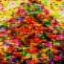

there are 12902 examples for "2.1" class. Here some of them:


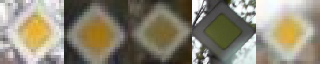

there are 133191 examples for "other" class. Here some of them:


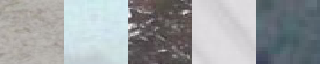

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.23, prediction=other, score=0.88037109375


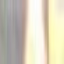

there are 144 examples for "5.23" class. Here some of them:


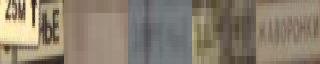

there are 133191 examples for "other" class. Here some of them:


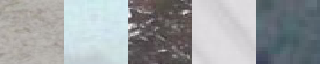

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=5.16, score=0.88037109375


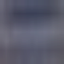

there are 403 examples for "5.7" class. Here some of them:


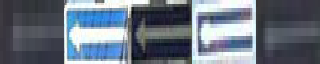

there are 6247 examples for "5.16" class. Here some of them:


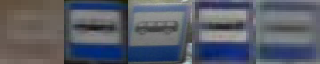

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.15, score=0.87744140625


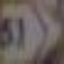

there are 1069 examples for "6.10" class. Here some of them:


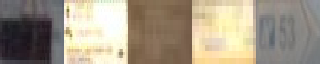

there are 12199 examples for "5.15" class. Here some of them:


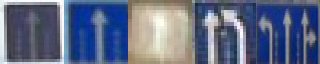

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=other, score=0.876953125


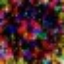

there are 416 examples for "4.4" class. Here some of them:


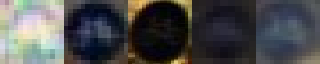

there are 133191 examples for "other" class. Here some of them:


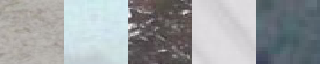

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.87451171875


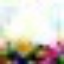

there are 30338 examples for "5.19" class. Here some of them:


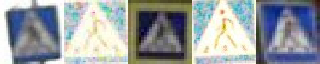

there are 3435 examples for "5.20" class. Here some of them:


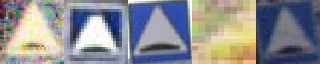

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.1, prediction=8.2, score=0.873046875


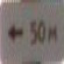

there are 362 examples for "8.1" class. Here some of them:


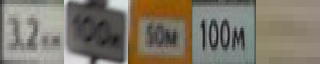

there are 2135 examples for "8.2" class. Here some of them:


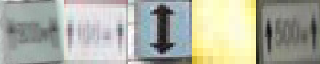

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.15, prediction=1.23, score=0.8720703125


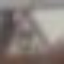

there are 264 examples for "1.15" class. Here some of them:


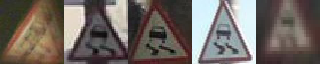

there are 2790 examples for "1.23" class. Here some of them:


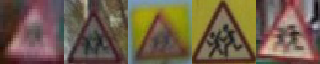

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=other, score=0.869140625


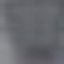

there are 5333 examples for "2.4" class. Here some of them:


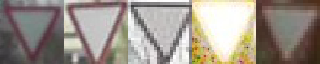

there are 133191 examples for "other" class. Here some of them:


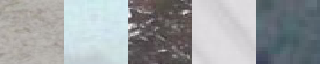

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=2.4, score=0.86865234375


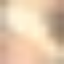

there are 689 examples for "8.22" class. Here some of them:


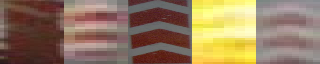

there are 5333 examples for "2.4" class. Here some of them:


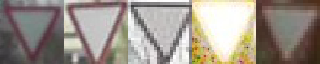

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=5.19, score=0.8662109375


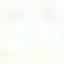

there are 133191 examples for "other" class. Here some of them:


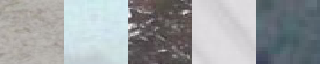

there are 30338 examples for "5.19" class. Here some of them:


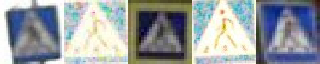

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.86474609375


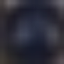

there are 3847 examples for "4.2" class. Here some of them:


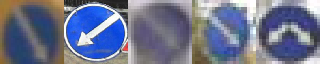

there are 416 examples for "4.4" class. Here some of them:


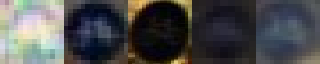

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.86474609375


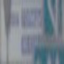

there are 851 examples for "6.9" class. Here some of them:


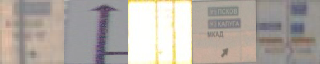

there are 1069 examples for "6.10" class. Here some of them:


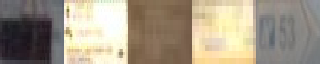

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=other, score=0.86279296875


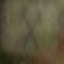

there are 303 examples for "8.5" class. Here some of them:


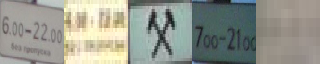

there are 133191 examples for "other" class. Here some of them:


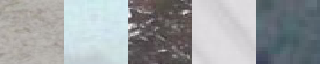

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.15, prediction=4.1, score=0.86181640625


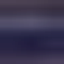

there are 12199 examples for "5.15" class. Here some of them:


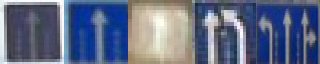

there are 5770 examples for "4.1" class. Here some of them:


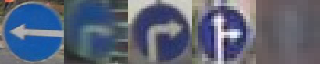

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.1, score=0.85986328125


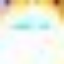

there are 3847 examples for "4.2" class. Here some of them:


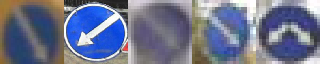

there are 5770 examples for "4.1" class. Here some of them:


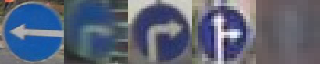

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.14, prediction=8.23, score=0.85986328125


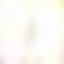

there are 84 examples for "8.14" class. Here some of them:


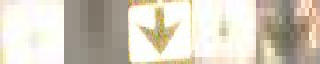

there are 319 examples for "8.23" class. Here some of them:


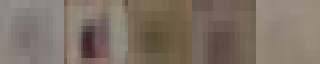

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=5.16, score=0.85888671875


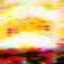

there are 689 examples for "8.22" class. Here some of them:


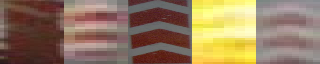

there are 6247 examples for "5.16" class. Here some of them:


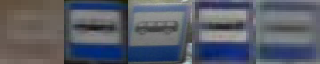

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.23, prediction=other, score=0.857421875


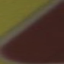

there are 2790 examples for "1.23" class. Here some of them:


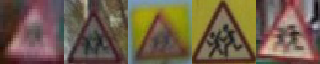

there are 133191 examples for "other" class. Here some of them:


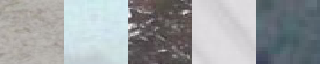

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.857421875


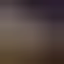

there are 3435 examples for "5.20" class. Here some of them:


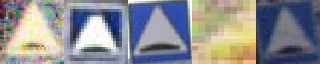

there are 30338 examples for "5.19" class. Here some of them:


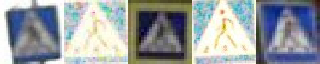

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.1, prediction=8.2, score=0.853515625


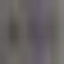

there are 362 examples for "8.1" class. Here some of them:


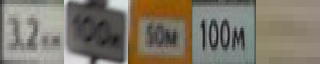

there are 2135 examples for "8.2" class. Here some of them:


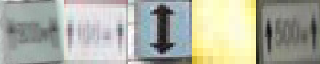

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.10, score=0.853515625


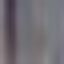

there are 61 examples for "8.17" class. Here some of them:


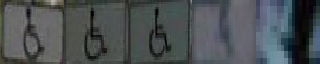

there are 1069 examples for "6.10" class. Here some of them:


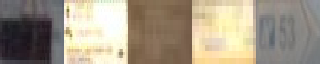

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.27, prediction=5.20, score=0.85205078125


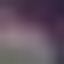

there are 4689 examples for "3.27" class. Here some of them:


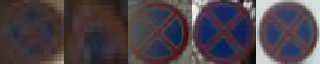

there are 3435 examples for "5.20" class. Here some of them:


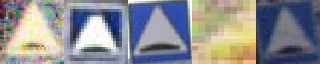

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.85205078125


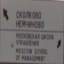

there are 1069 examples for "6.10" class. Here some of them:


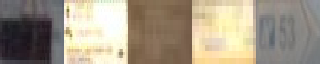

there are 851 examples for "6.9" class. Here some of them:


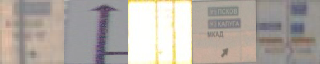

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.15, prediction=4.1, score=0.85107421875


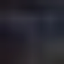

there are 12199 examples for "5.15" class. Here some of them:


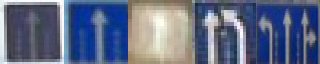

there are 5770 examples for "4.1" class. Here some of them:


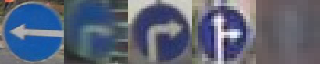

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=4.1, score=0.84912109375


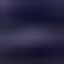

there are 50 examples for "5.4" class. Here some of them:


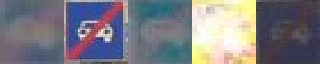

there are 5770 examples for "4.1" class. Here some of them:


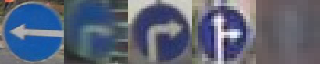

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.11, prediction=other, score=0.84814453125


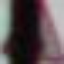

there are 1021 examples for "1.11" class. Here some of them:


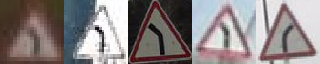

there are 133191 examples for "other" class. Here some of them:


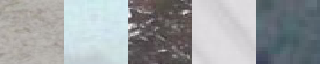

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.84716796875


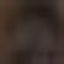

there are 3847 examples for "4.2" class. Here some of them:


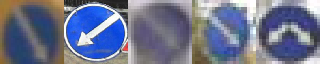

there are 30338 examples for "5.19" class. Here some of them:


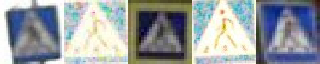

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.8427734375


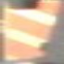

there are 689 examples for "8.22" class. Here some of them:


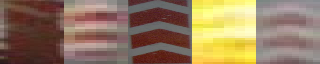

there are 133191 examples for "other" class. Here some of them:


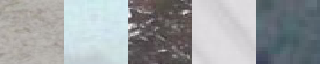

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.8388671875


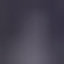

there are 30338 examples for "5.19" class. Here some of them:


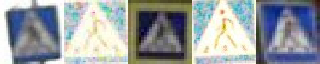

there are 3435 examples for "5.20" class. Here some of them:


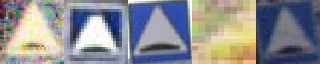

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.83447265625


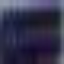

there are 403 examples for "5.7" class. Here some of them:


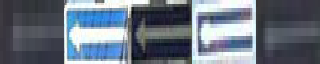

there are 1069 examples for "6.10" class. Here some of them:


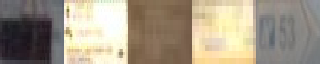

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=5.6, score=0.8330078125


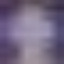

there are 1144 examples for "5.5" class. Here some of them:


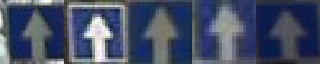

there are 677 examples for "5.6" class. Here some of them:


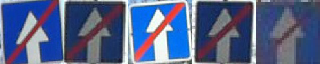

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.83203125


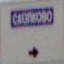

there are 1069 examples for "6.10" class. Here some of them:


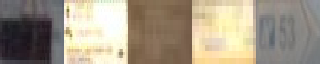

there are 851 examples for "6.9" class. Here some of them:


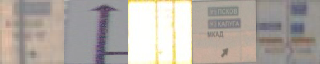

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.83056640625


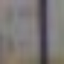

there are 1069 examples for "6.10" class. Here some of them:


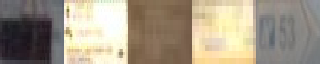

there are 851 examples for "6.9" class. Here some of them:


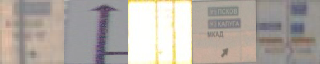

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.25, prediction=5.19, score=0.82958984375


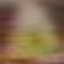

there are 1048 examples for "1.25" class. Here some of them:


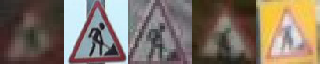

there are 30338 examples for "5.19" class. Here some of them:


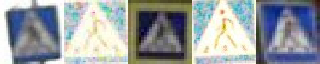

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=2.1, score=0.8291015625


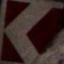

there are 559 examples for "1.34" class. Here some of them:


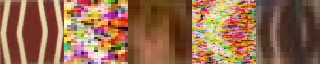

there are 12902 examples for "2.1" class. Here some of them:


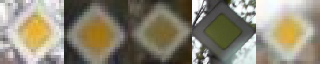

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=2.1, score=0.82861328125


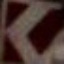

there are 559 examples for "1.34" class. Here some of them:


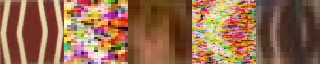

there are 12902 examples for "2.1" class. Here some of them:


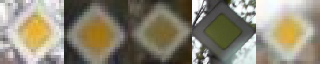

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=2.1, score=0.82763671875


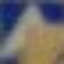

there are 3435 examples for "5.20" class. Here some of them:


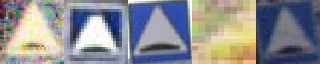

there are 12902 examples for "2.1" class. Here some of them:


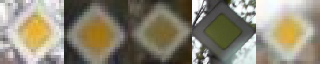

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.82666015625


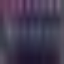

there are 403 examples for "5.7" class. Here some of them:


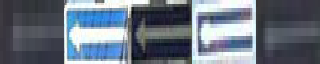

there are 1069 examples for "6.10" class. Here some of them:


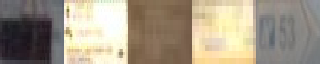

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=8, score=0.82666015625


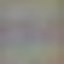

there are 2135 examples for "8.2" class. Here some of them:


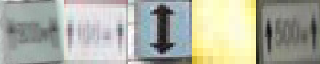

there are 98 examples for "8" class. Here some of them:


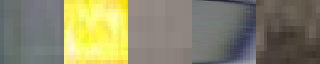

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.82568359375


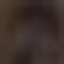

there are 3847 examples for "4.2" class. Here some of them:


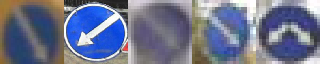

there are 30338 examples for "5.19" class. Here some of them:


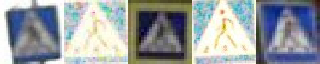

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=2.1, score=0.8251953125


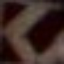

there are 559 examples for "1.34" class. Here some of them:


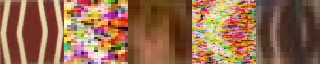

there are 12902 examples for "2.1" class. Here some of them:


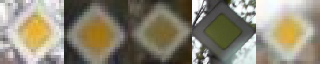

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.1, prediction=other, score=0.8232421875


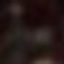

there are 1900 examples for "3.1" class. Here some of them:


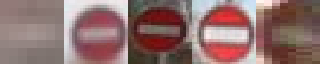

there are 133191 examples for "other" class. Here some of them:


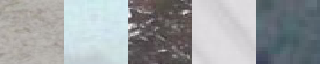

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.8203125


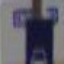

there are 1069 examples for "6.10" class. Here some of them:


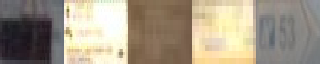

there are 851 examples for "6.9" class. Here some of them:


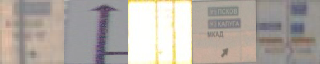

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=5.16, score=0.81396484375


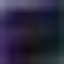

there are 403 examples for "5.7" class. Here some of them:


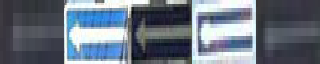

there are 6247 examples for "5.16" class. Here some of them:


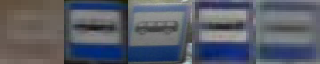

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.81005859375


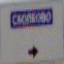

there are 1069 examples for "6.10" class. Here some of them:


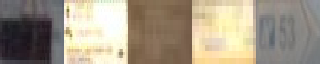

there are 851 examples for "6.9" class. Here some of them:


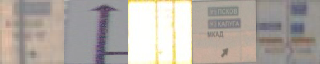

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.25, prediction=3.21, score=0.80908203125


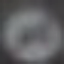

there are 212 examples for "3.25" class. Here some of them:


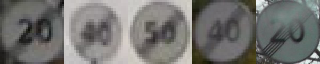

there are 348 examples for "3.21" class. Here some of them:


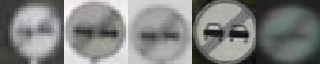

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.80810546875


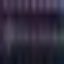

there are 403 examples for "5.7" class. Here some of them:


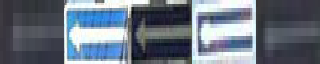

there are 1069 examples for "6.10" class. Here some of them:


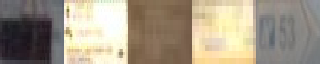

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.16, score=0.80712890625


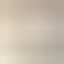

there are 30338 examples for "5.19" class. Here some of them:


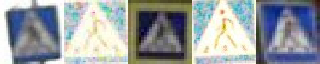

there are 6247 examples for "5.16" class. Here some of them:


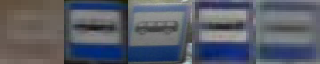

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.8056640625


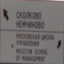

there are 1069 examples for "6.10" class. Here some of them:


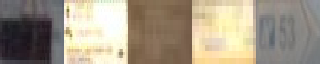

there are 851 examples for "6.9" class. Here some of them:


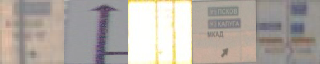

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=3.27, score=0.79833984375


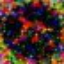

there are 416 examples for "4.4" class. Here some of them:


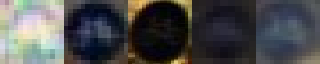

there are 4689 examples for "3.27" class. Here some of them:


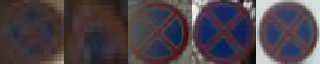

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.796875


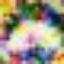

there are 3847 examples for "4.2" class. Here some of them:


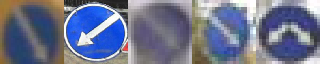

there are 416 examples for "4.4" class. Here some of them:


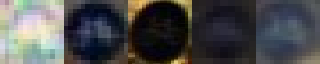

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.24, prediction=6.4, score=0.794921875


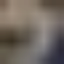

there are 335 examples for "8.24" class. Here some of them:


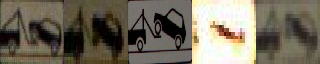

there are 1423 examples for "6.4" class. Here some of them:


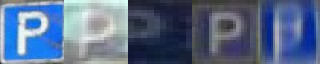

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=8.22, score=0.79296875


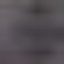

there are 2135 examples for "8.2" class. Here some of them:


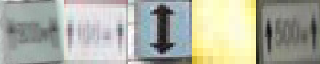

there are 689 examples for "8.22" class. Here some of them:


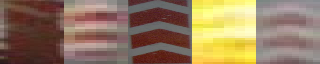

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.13, prediction=3.27, score=0.78955078125


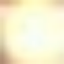

there are 368 examples for "3.13" class. Here some of them:


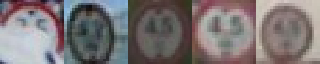

there are 4689 examples for "3.27" class. Here some of them:


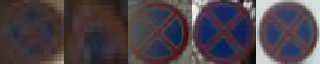

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.11, prediction=6.6, score=0.7890625


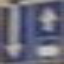

there are 81 examples for "5.11" class. Here some of them:


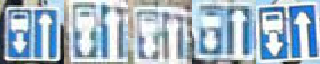

there are 925 examples for "6.6" class. Here some of them:


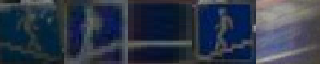

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.24, score=0.7880859375


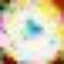

there are 225 examples for "4.3" class. Here some of them:


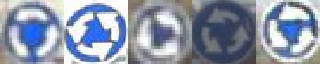

there are 5646 examples for "3.24" class. Here some of them:


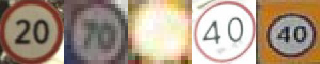

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=5.19, score=0.78515625


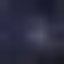

there are 133 examples for "5.3" class. Here some of them:


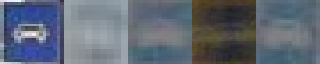

there are 30338 examples for "5.19" class. Here some of them:


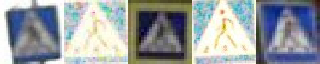

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=8.24, score=0.78515625


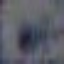

there are 319 examples for "8.23" class. Here some of them:


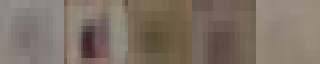

there are 335 examples for "8.24" class. Here some of them:


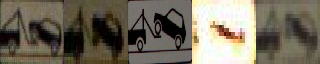

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.78271484375


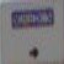

there are 1069 examples for "6.10" class. Here some of them:


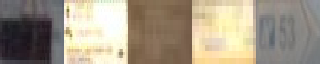

there are 851 examples for "6.9" class. Here some of them:


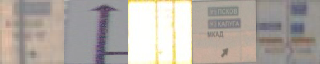

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.7822265625


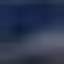

there are 30338 examples for "5.19" class. Here some of them:


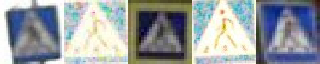

there are 3435 examples for "5.20" class. Here some of them:


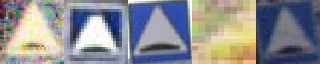

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.77978515625


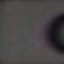

there are 1384 examples for "6.16" class. Here some of them:


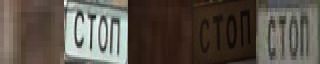

there are 133191 examples for "other" class. Here some of them:


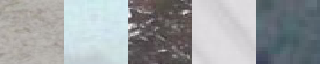

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.24, prediction=3.20, score=0.77880859375


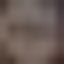

there are 5646 examples for "3.24" class. Here some of them:


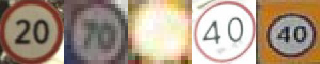

there are 1779 examples for "3.20" class. Here some of them:


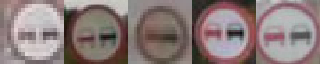

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.23, prediction=6.10, score=0.77734375


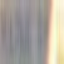

there are 144 examples for "5.23" class. Here some of them:


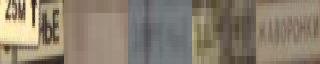

there are 1069 examples for "6.10" class. Here some of them:


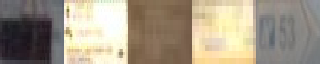

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=4.1, score=0.775390625


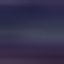

there are 50 examples for "5.4" class. Here some of them:


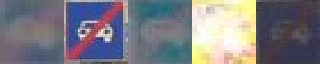

there are 5770 examples for "4.1" class. Here some of them:


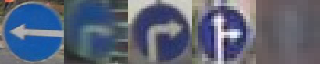

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=8.2, score=0.7744140625


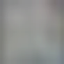

there are 303 examples for "8.5" class. Here some of them:


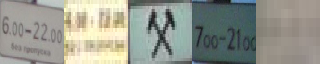

there are 2135 examples for "8.2" class. Here some of them:


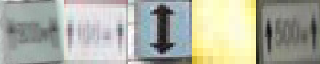

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=other, score=0.77294921875


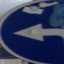

there are 5770 examples for "4.1" class. Here some of them:


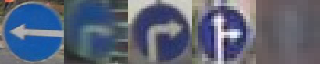

there are 133191 examples for "other" class. Here some of them:


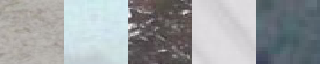

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.771484375


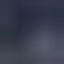

there are 30338 examples for "5.19" class. Here some of them:


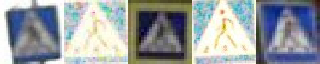

there are 3435 examples for "5.20" class. Here some of them:


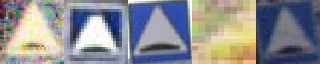

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.11, score=0.771484375


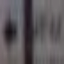

there are 1069 examples for "6.10" class. Here some of them:


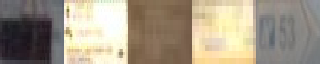

there are 37 examples for "6.11" class. Here some of them:


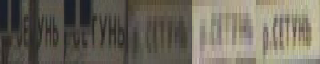

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=6.10, score=0.7705078125


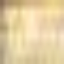

there are 303 examples for "8.5" class. Here some of them:


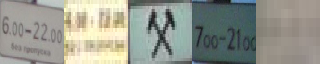

there are 1069 examples for "6.10" class. Here some of them:


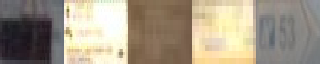

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.11, prediction=6.9, score=0.76708984375


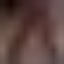

there are 1021 examples for "1.11" class. Here some of them:


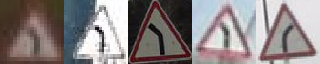

there are 851 examples for "6.9" class. Here some of them:


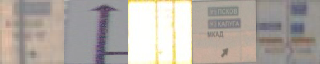

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.7646484375


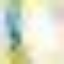

there are 30338 examples for "5.19" class. Here some of them:


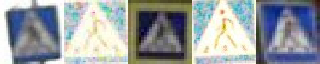

there are 3435 examples for "5.20" class. Here some of them:


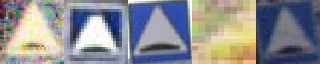

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=8.2, score=0.7646484375


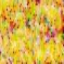

there are 133191 examples for "other" class. Here some of them:


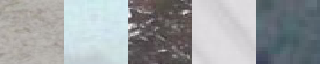

there are 2135 examples for "8.2" class. Here some of them:


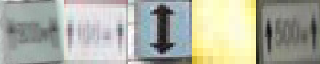

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.763671875


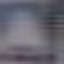

there are 3435 examples for "5.20" class. Here some of them:


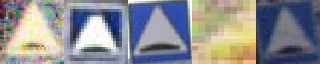

there are 30338 examples for "5.19" class. Here some of them:


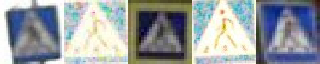

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.16, score=0.763671875


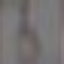

there are 61 examples for "8.17" class. Here some of them:


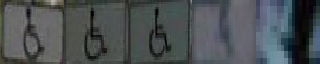

there are 1384 examples for "6.16" class. Here some of them:


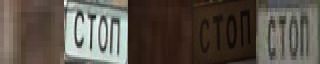

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=6.10, score=0.763671875


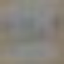

there are 2135 examples for "8.2" class. Here some of them:


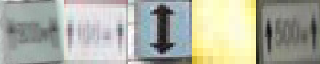

there are 1069 examples for "6.10" class. Here some of them:


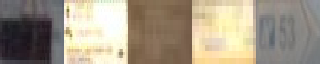

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.2, prediction=2.1, score=0.7626953125


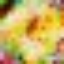

there are 677 examples for "2.2" class. Here some of them:


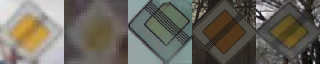

there are 12902 examples for "2.1" class. Here some of them:


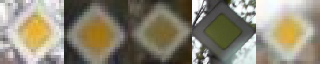

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=other, score=0.7626953125


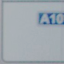

there are 851 examples for "6.9" class. Here some of them:


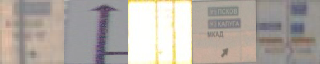

there are 133191 examples for "other" class. Here some of them:


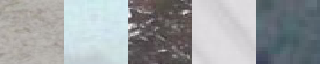

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=other, score=0.76123046875


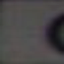

there are 1384 examples for "6.16" class. Here some of them:


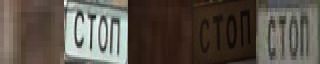

there are 133191 examples for "other" class. Here some of them:


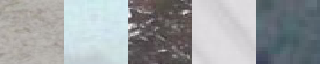

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=5.19, score=0.7578125


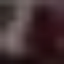

there are 559 examples for "1.34" class. Here some of them:


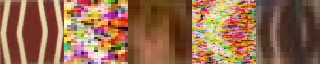

there are 30338 examples for "5.19" class. Here some of them:


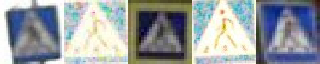

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.1, score=0.75


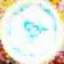

there are 225 examples for "4.3" class. Here some of them:


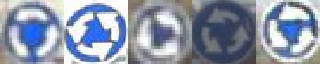

there are 5770 examples for "4.1" class. Here some of them:


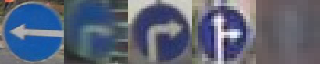

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=5.20, score=0.7490234375


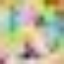

there are 416 examples for "4.4" class. Here some of them:


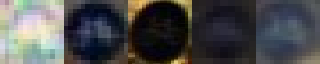

there are 3435 examples for "5.20" class. Here some of them:


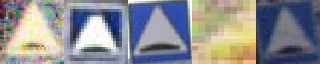

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.74755859375


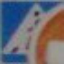

there are 30338 examples for "5.19" class. Here some of them:


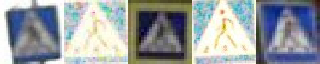

there are 133191 examples for "other" class. Here some of them:


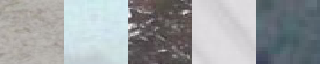

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.24, prediction=2.4, score=0.74560546875


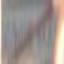

there are 143 examples for "5.24" class. Here some of them:


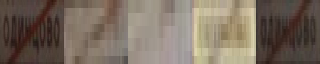

there are 5333 examples for "2.4" class. Here some of them:


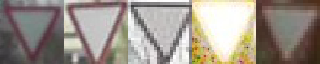

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.4, score=0.744140625


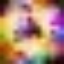

there are 225 examples for "4.3" class. Here some of them:


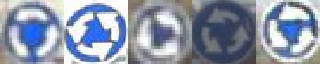

there are 416 examples for "4.4" class. Here some of them:


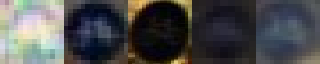

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.13, prediction=1.14, score=0.7431640625


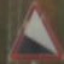

there are 78 examples for "1.13" class. Here some of them:


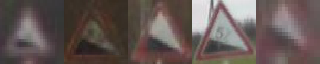

there are 99 examples for "1.14" class. Here some of them:


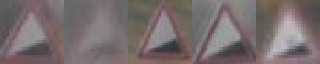

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.7392578125


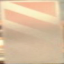

there are 689 examples for "8.22" class. Here some of them:


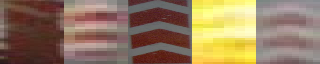

there are 133191 examples for "other" class. Here some of them:


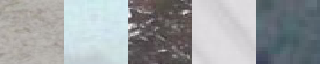

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=8.6, score=0.73779296875


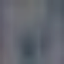

there are 319 examples for "8.23" class. Here some of them:


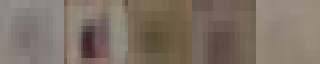

there are 130 examples for "8.6" class. Here some of them:


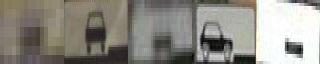

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.734375


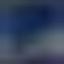

there are 30338 examples for "5.19" class. Here some of them:


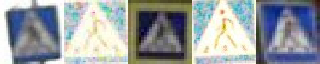

there are 3435 examples for "5.20" class. Here some of them:


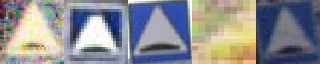

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=4.1, score=0.72900390625


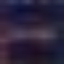

there are 50 examples for "5.4" class. Here some of them:


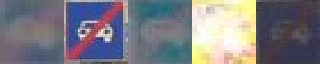

there are 5770 examples for "4.1" class. Here some of them:


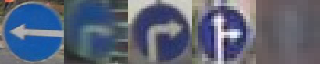

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=7.5, prediction=5.16, score=0.72900390625


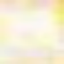

there are 346 examples for "7.5" class. Here some of them:


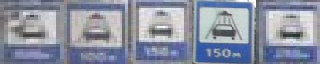

there are 6247 examples for "5.16" class. Here some of them:


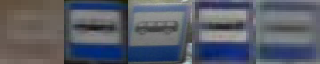

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.72802734375


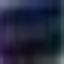

there are 403 examples for "5.7" class. Here some of them:


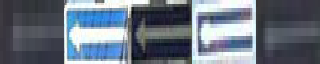

there are 1069 examples for "6.10" class. Here some of them:


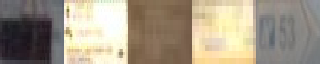

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.72607421875


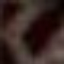

there are 559 examples for "1.34" class. Here some of them:


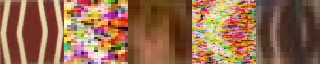

there are 133191 examples for "other" class. Here some of them:


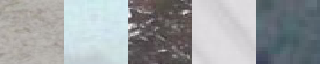

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.71923828125


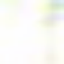

there are 30338 examples for "5.19" class. Here some of them:


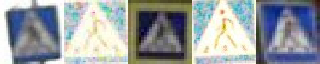

there are 133191 examples for "other" class. Here some of them:


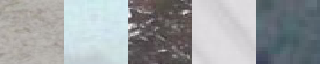

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.31, prediction=3.25, score=0.71875


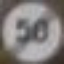

there are 188 examples for "3.31" class. Here some of them:


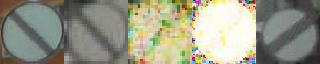

there are 212 examples for "3.25" class. Here some of them:


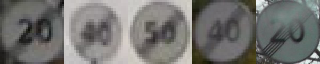

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.24, score=0.71728515625


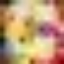

there are 225 examples for "4.3" class. Here some of them:


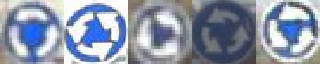

there are 5646 examples for "3.24" class. Here some of them:


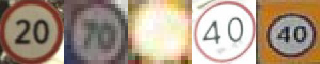

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.71728515625


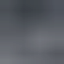

there are 3435 examples for "5.20" class. Here some of them:


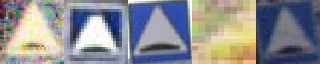

there are 30338 examples for "5.19" class. Here some of them:


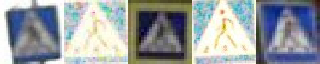

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=3.24, score=0.71630859375


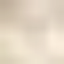

there are 30338 examples for "5.19" class. Here some of them:


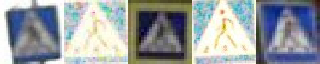

there are 5646 examples for "3.24" class. Here some of them:


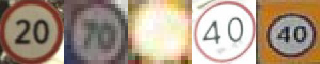

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.71240234375


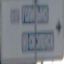

there are 851 examples for "6.9" class. Here some of them:


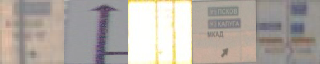

there are 1069 examples for "6.10" class. Here some of them:


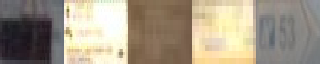

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=3.24, score=0.7119140625


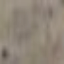

there are 133191 examples for "other" class. Here some of them:


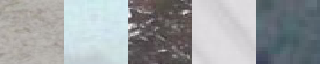

there are 5646 examples for "3.24" class. Here some of them:


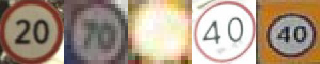

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.71142578125


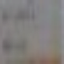

there are 1069 examples for "6.10" class. Here some of them:


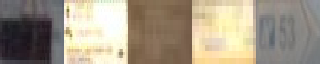

there are 851 examples for "6.9" class. Here some of them:


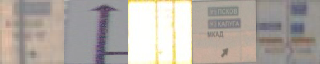

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=8.2, score=0.71142578125


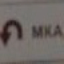

there are 133191 examples for "other" class. Here some of them:


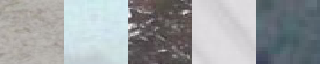

there are 2135 examples for "8.2" class. Here some of them:


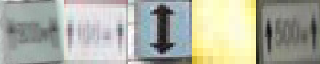

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.7080078125


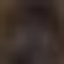

there are 3847 examples for "4.2" class. Here some of them:


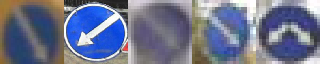

there are 30338 examples for "5.19" class. Here some of them:


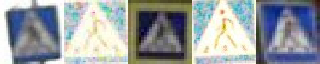

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=5.15, score=0.70751953125


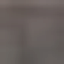

there are 5333 examples for "2.4" class. Here some of them:


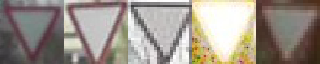

there are 12199 examples for "5.15" class. Here some of them:


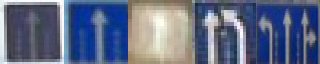

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.70703125


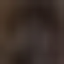

there are 3847 examples for "4.2" class. Here some of them:


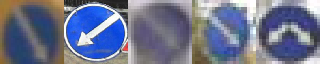

there are 30338 examples for "5.19" class. Here some of them:


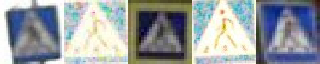

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.1, prediction=1.11, score=0.7060546875


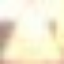

there are 208 examples for "1.1" class. Here some of them:


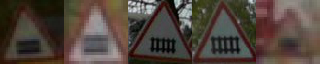

there are 1021 examples for "1.11" class. Here some of them:


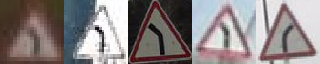

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.70361328125


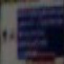

there are 851 examples for "6.9" class. Here some of them:


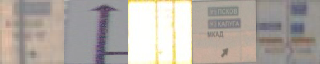

there are 1069 examples for "6.10" class. Here some of them:


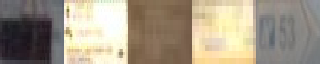

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.27, prediction=4.4, score=0.7001953125


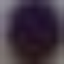

there are 4689 examples for "3.27" class. Here some of them:


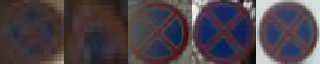

there are 416 examples for "4.4" class. Here some of them:


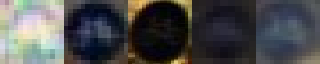

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=2.1, score=0.69970703125


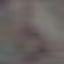

there are 61 examples for "8.17" class. Here some of them:


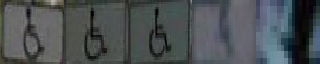

there are 12902 examples for "2.1" class. Here some of them:


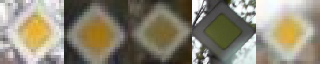

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=4.2, score=0.69873046875


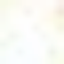

there are 30338 examples for "5.19" class. Here some of them:


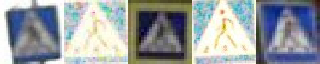

there are 3847 examples for "4.2" class. Here some of them:


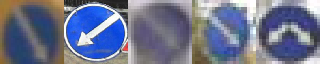

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.1, score=0.69580078125


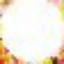

there are 225 examples for "4.3" class. Here some of them:


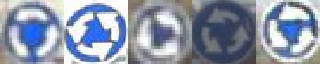

there are 5770 examples for "4.1" class. Here some of them:


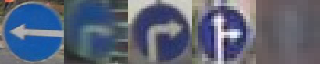

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=other, score=0.69580078125


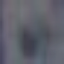

there are 319 examples for "8.23" class. Here some of them:


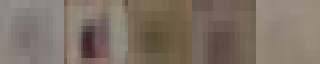

there are 133191 examples for "other" class. Here some of them:


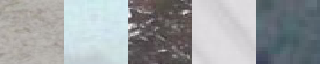

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.1, prediction=1.12, score=0.693359375


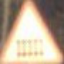

there are 208 examples for "1.1" class. Here some of them:


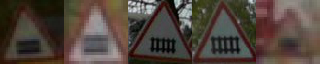

there are 391 examples for "1.12" class. Here some of them:


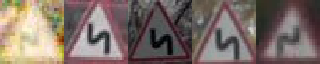

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=4.1, score=0.6923828125


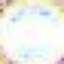

there are 416 examples for "4.4" class. Here some of them:


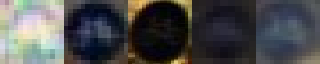

there are 5770 examples for "4.1" class. Here some of them:


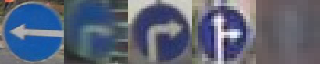

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.68505859375


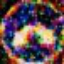

there are 3847 examples for "4.2" class. Here some of them:


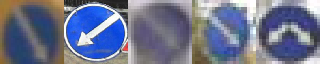

there are 416 examples for "4.4" class. Here some of them:


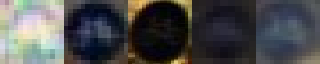

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.1, prediction=5.20, score=0.6845703125


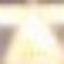

there are 208 examples for "1.1" class. Here some of them:


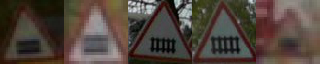

there are 3435 examples for "5.20" class. Here some of them:


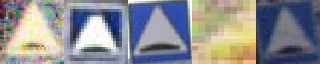

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.68408203125


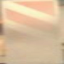

there are 689 examples for "8.22" class. Here some of them:


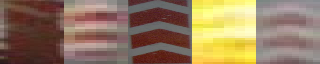

there are 133191 examples for "other" class. Here some of them:


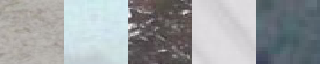

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.68017578125


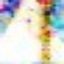

there are 30338 examples for "5.19" class. Here some of them:


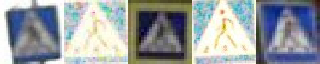

there are 133191 examples for "other" class. Here some of them:


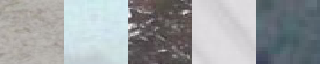

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.68017578125


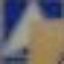

there are 3435 examples for "5.20" class. Here some of them:


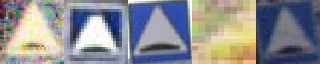

there are 30338 examples for "5.19" class. Here some of them:


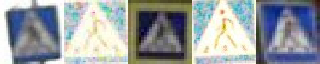

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=5.19, score=0.67724609375


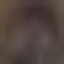

there are 3847 examples for "4.2" class. Here some of them:


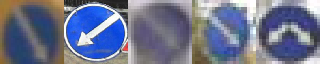

there are 30338 examples for "5.19" class. Here some of them:


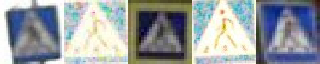

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.23, prediction=6.10, score=0.67724609375


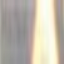

there are 144 examples for "5.23" class. Here some of them:


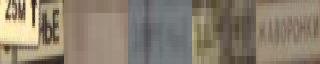

there are 1069 examples for "6.10" class. Here some of them:


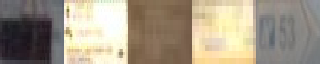

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=6.9, score=0.673828125


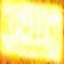

there are 303 examples for "8.5" class. Here some of them:


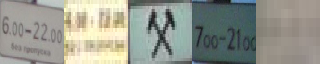

there are 851 examples for "6.9" class. Here some of them:


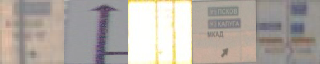

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=5.6, score=0.6728515625


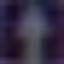

there are 1144 examples for "5.5" class. Here some of them:


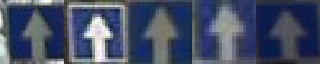

there are 677 examples for "5.6" class. Here some of them:


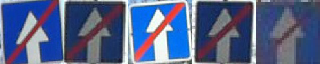

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=6.16, score=0.66455078125


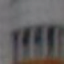

there are 133191 examples for "other" class. Here some of them:


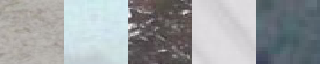

there are 1384 examples for "6.16" class. Here some of them:


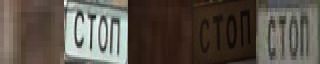

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=4.1, score=0.66259765625


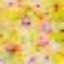

there are 133191 examples for "other" class. Here some of them:


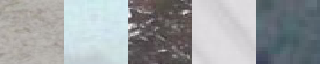

there are 5770 examples for "4.1" class. Here some of them:


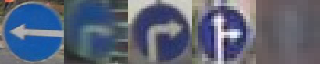

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.10, prediction=1.25, score=0.66064453125


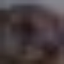

there are 95 examples for "3.10" class. Here some of them:


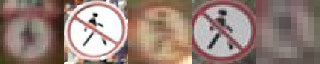

there are 1048 examples for "1.25" class. Here some of them:


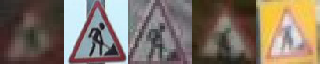

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=4.1, score=0.6572265625


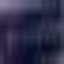

there are 403 examples for "5.7" class. Here some of them:


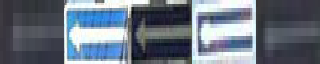

there are 5770 examples for "4.1" class. Here some of them:


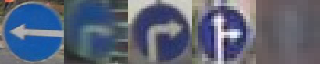

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=4.4, score=0.65478515625


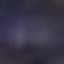

there are 50 examples for "5.4" class. Here some of them:


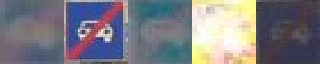

there are 416 examples for "4.4" class. Here some of them:


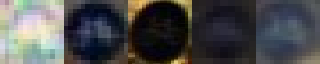

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=2.1, score=0.64501953125


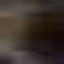

there are 559 examples for "1.34" class. Here some of them:


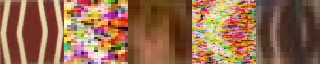

there are 12902 examples for "2.1" class. Here some of them:


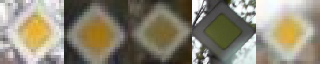

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.23, prediction=8.24, score=0.642578125


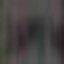

there are 144 examples for "5.23" class. Here some of them:


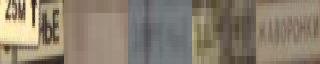

there are 335 examples for "8.24" class. Here some of them:


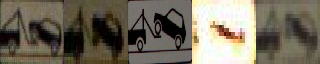

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=5.19, score=0.642578125


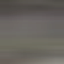

there are 61 examples for "8.17" class. Here some of them:


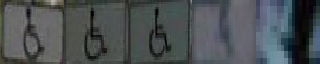

there are 30338 examples for "5.19" class. Here some of them:


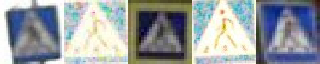

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.10, score=0.6416015625


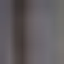

there are 61 examples for "8.17" class. Here some of them:


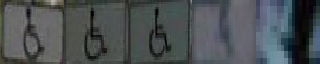

there are 1069 examples for "6.10" class. Here some of them:


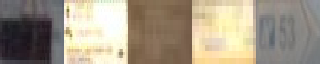

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=5.24, score=0.640625


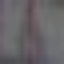

there are 61 examples for "8.17" class. Here some of them:


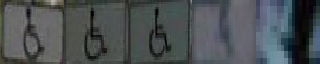

there are 143 examples for "5.24" class. Here some of them:


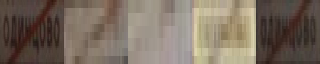

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.6396484375


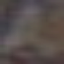

there are 3435 examples for "5.20" class. Here some of them:


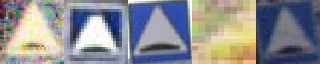

there are 30338 examples for "5.19" class. Here some of them:


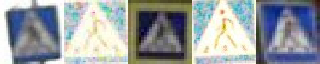

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.1, prediction=8.2, score=0.6396484375


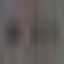

there are 362 examples for "8.1" class. Here some of them:


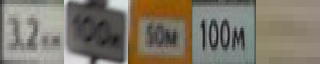

there are 2135 examples for "8.2" class. Here some of them:


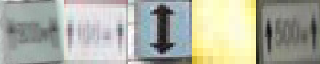

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.63916015625


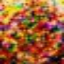

there are 12902 examples for "2.1" class. Here some of them:


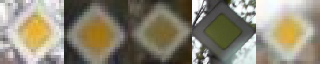

there are 133191 examples for "other" class. Here some of them:


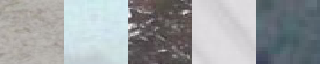

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=5.19, score=0.638671875


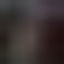

there are 559 examples for "1.34" class. Here some of them:


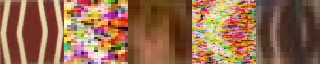

there are 30338 examples for "5.19" class. Here some of them:


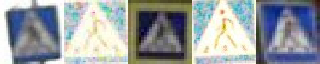

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=8.14, score=0.63818359375


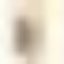

there are 319 examples for "8.23" class. Here some of them:


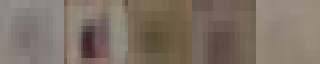

there are 84 examples for "8.14" class. Here some of them:


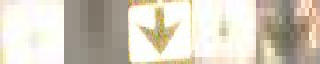

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.63427734375


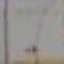

there are 1069 examples for "6.10" class. Here some of them:


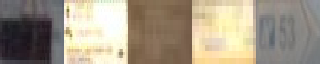

there are 133191 examples for "other" class. Here some of them:


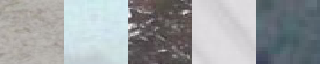

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.17, prediction=1.1, score=0.63232421875


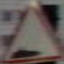

there are 1648 examples for "1.17" class. Here some of them:


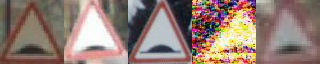

there are 208 examples for "1.1" class. Here some of them:


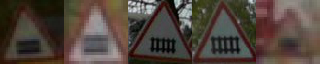

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.27, prediction=4.1, score=0.630859375


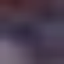

there are 4689 examples for "3.27" class. Here some of them:


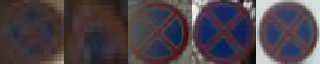

there are 5770 examples for "4.1" class. Here some of them:


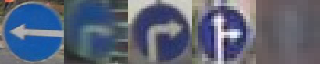

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.15, prediction=4.2, score=0.625


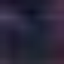

there are 12199 examples for "5.15" class. Here some of them:


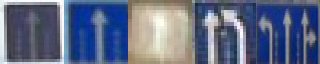

there are 3847 examples for "4.2" class. Here some of them:


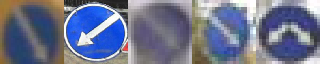

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=8.4, score=0.62060546875


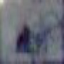

there are 319 examples for "8.23" class. Here some of them:


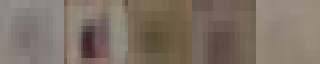

there are 206 examples for "8.4" class. Here some of them:


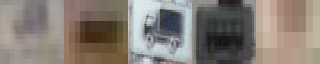

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=7.3, prediction=6.4, score=0.61962890625


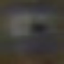

there are 1115 examples for "7.3" class. Here some of them:


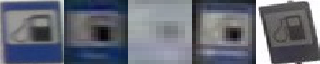

there are 1423 examples for "6.4" class. Here some of them:


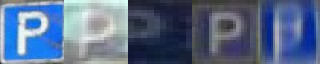

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.61865234375


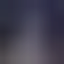

there are 30338 examples for "5.19" class. Here some of them:


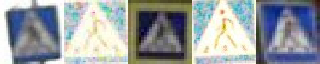

there are 3435 examples for "5.20" class. Here some of them:


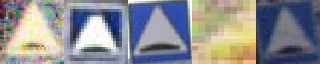

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.27, score=0.6123046875


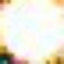

there are 225 examples for "4.3" class. Here some of them:


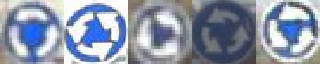

there are 4689 examples for "3.27" class. Here some of them:


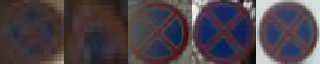

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.13, prediction=5.20, score=0.6123046875


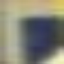

there are 987 examples for "8.13" class. Here some of them:


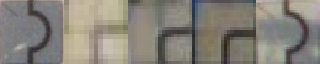

there are 3435 examples for "5.20" class. Here some of them:


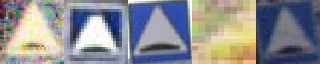

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.31, prediction=8.22, score=0.61083984375


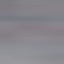

there are 55 examples for "5.31" class. Here some of them:


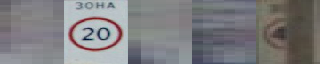

there are 689 examples for "8.22" class. Here some of them:


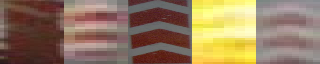

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.60693359375


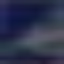

there are 30338 examples for "5.19" class. Here some of them:


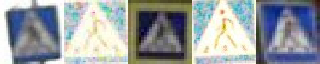

there are 3435 examples for "5.20" class. Here some of them:


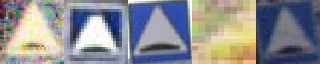

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=other, score=0.60400390625


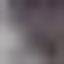

there are 5333 examples for "2.4" class. Here some of them:


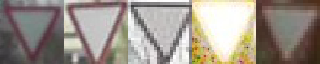

there are 133191 examples for "other" class. Here some of them:


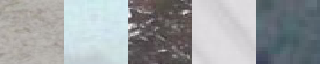

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=4.1, score=0.59765625


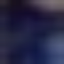

there are 133 examples for "5.3" class. Here some of them:


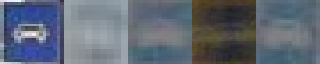

there are 5770 examples for "4.1" class. Here some of them:


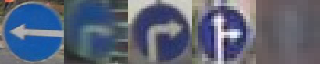

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=1.16, score=0.5947265625


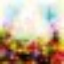

there are 30338 examples for "5.19" class. Here some of them:


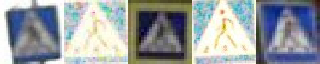

there are 415 examples for "1.16" class. Here some of them:


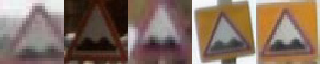

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.5947265625


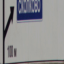

there are 851 examples for "6.9" class. Here some of them:


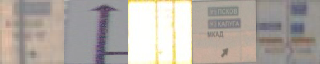

there are 1069 examples for "6.10" class. Here some of them:


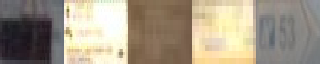

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=6.10, score=0.591796875


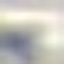

there are 6247 examples for "5.16" class. Here some of them:


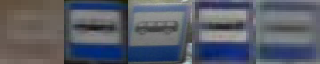

there are 1069 examples for "6.10" class. Here some of them:


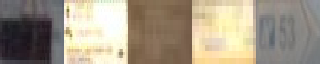

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=5.19, score=0.583984375


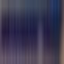

there are 3435 examples for "5.20" class. Here some of them:


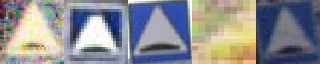

there are 30338 examples for "5.19" class. Here some of them:


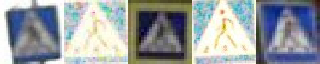

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8, prediction=8.2, score=0.58154296875


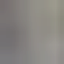

there are 98 examples for "8" class. Here some of them:


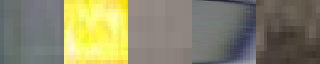

there are 2135 examples for "8.2" class. Here some of them:


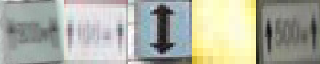

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.27, score=0.580078125


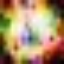

there are 225 examples for "4.3" class. Here some of them:


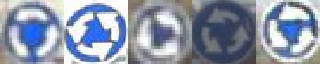

there are 4689 examples for "3.27" class. Here some of them:


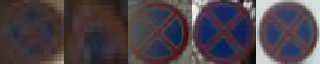

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=6.10, score=0.5791015625


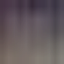

there are 5333 examples for "2.4" class. Here some of them:


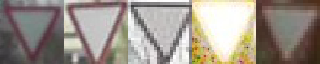

there are 1069 examples for "6.10" class. Here some of them:


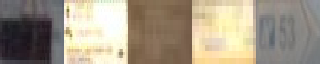

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.13, prediction=3.27, score=0.5791015625


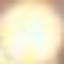

there are 368 examples for "3.13" class. Here some of them:


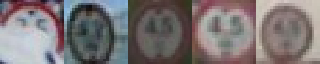

there are 4689 examples for "3.27" class. Here some of them:


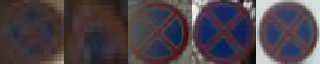

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.578125


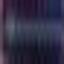

there are 403 examples for "5.7" class. Here some of them:


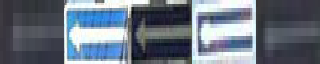

there are 1069 examples for "6.10" class. Here some of them:


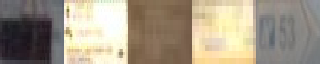

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=5.19, score=0.57763671875


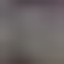

there are 5333 examples for "2.4" class. Here some of them:


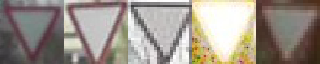

there are 30338 examples for "5.19" class. Here some of them:


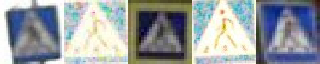

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.1, prediction=1.12, score=0.57666015625


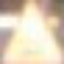

there are 208 examples for "1.1" class. Here some of them:


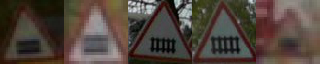

there are 391 examples for "1.12" class. Here some of them:


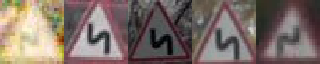

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=2.4, score=0.57568359375


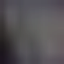

there are 61 examples for "8.17" class. Here some of them:


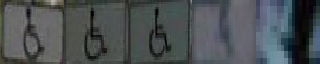

there are 5333 examples for "2.4" class. Here some of them:


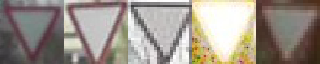

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=5.19, score=0.5751953125


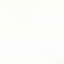

there are 133191 examples for "other" class. Here some of them:


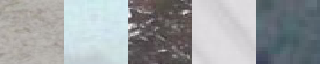

there are 30338 examples for "5.19" class. Here some of them:


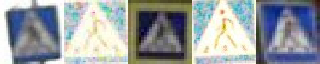

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.15, score=0.5732421875


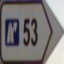

there are 1069 examples for "6.10" class. Here some of them:


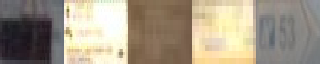

there are 12199 examples for "5.15" class. Here some of them:


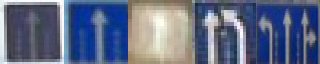

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=4.1, score=0.572265625


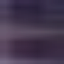

there are 50 examples for "5.4" class. Here some of them:


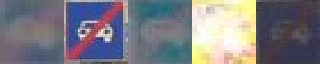

there are 5770 examples for "4.1" class. Here some of them:


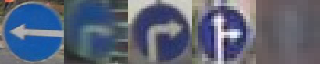

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=4.4, score=0.5673828125


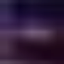

there are 50 examples for "5.4" class. Here some of them:


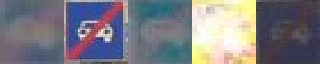

there are 416 examples for "4.4" class. Here some of them:


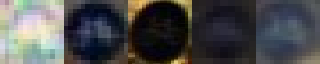

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=5.16, score=0.56689453125


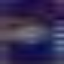

there are 50 examples for "5.4" class. Here some of them:


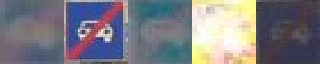

there are 6247 examples for "5.16" class. Here some of them:


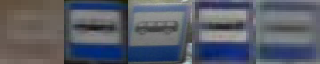

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=6.6, score=0.56591796875


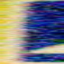

there are 30338 examples for "5.19" class. Here some of them:


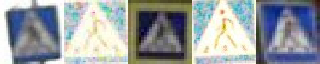

there are 925 examples for "6.6" class. Here some of them:


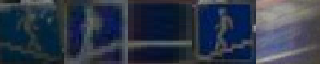

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=3.1, score=0.56591796875


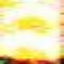

there are 689 examples for "8.22" class. Here some of them:


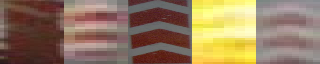

there are 1900 examples for "3.1" class. Here some of them:


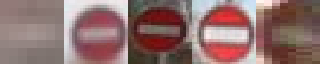

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.5654296875


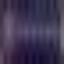

there are 403 examples for "5.7" class. Here some of them:


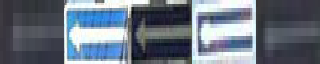

there are 1069 examples for "6.10" class. Here some of them:


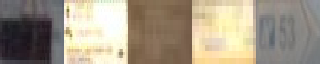

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.56494140625


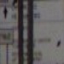

there are 1069 examples for "6.10" class. Here some of them:


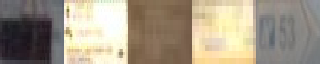

there are 851 examples for "6.9" class. Here some of them:


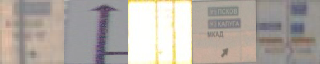

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.14, prediction=6.7, score=0.5634765625


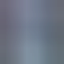

there are 433 examples for "5.14" class. Here some of them:


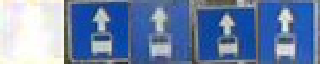

there are 226 examples for "6.7" class. Here some of them:


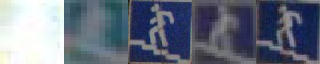

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.56201171875


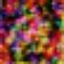

there are 30338 examples for "5.19" class. Here some of them:


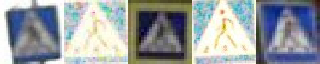

there are 133191 examples for "other" class. Here some of them:


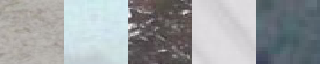

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.15, prediction=1.22, score=0.56005859375


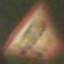

there are 264 examples for "1.15" class. Here some of them:


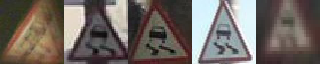

there are 928 examples for "1.22" class. Here some of them:


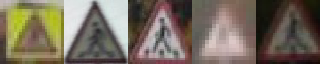

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.14, prediction=other, score=0.556640625


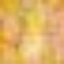

there are 433 examples for "5.14" class. Here some of them:


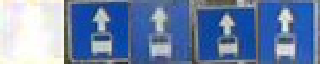

there are 133191 examples for "other" class. Here some of them:


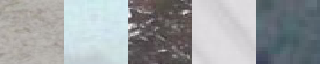

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=1.34, score=0.556640625


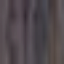

there are 1384 examples for "6.16" class. Here some of them:


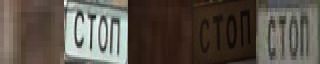

there are 559 examples for "1.34" class. Here some of them:


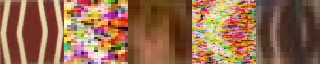

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.11, prediction=8.2, score=0.5556640625


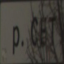

there are 37 examples for "6.11" class. Here some of them:


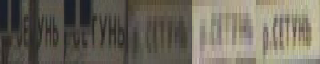

there are 2135 examples for "8.2" class. Here some of them:


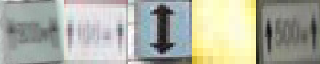

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.9, score=0.55517578125


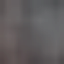

there are 61 examples for "8.17" class. Here some of them:


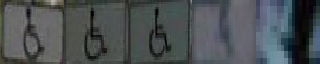

there are 851 examples for "6.9" class. Here some of them:


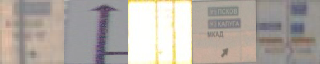

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.55419921875


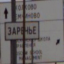

there are 1069 examples for "6.10" class. Here some of them:


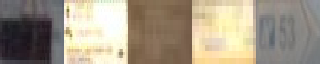

there are 851 examples for "6.9" class. Here some of them:


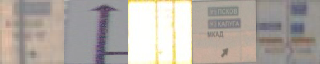

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=8.1, score=0.5537109375


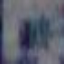

there are 319 examples for "8.23" class. Here some of them:


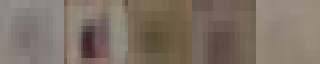

there are 362 examples for "8.1" class. Here some of them:


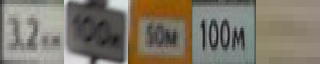

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=4.2, score=0.54833984375


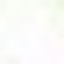

there are 30338 examples for "5.19" class. Here some of them:


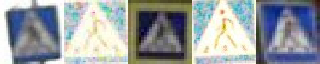

there are 3847 examples for "4.2" class. Here some of them:


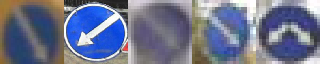

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=5.16, score=0.54443359375


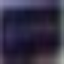

there are 403 examples for "5.7" class. Here some of them:


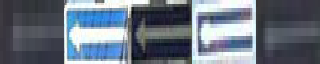

there are 6247 examples for "5.16" class. Here some of them:


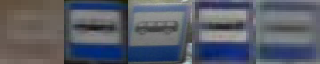

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=8.1, score=0.54248046875


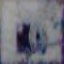

there are 319 examples for "8.23" class. Here some of them:


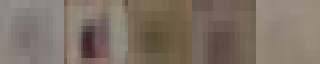

there are 362 examples for "8.1" class. Here some of them:


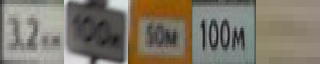

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.27, score=0.5419921875


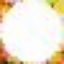

there are 225 examples for "4.3" class. Here some of them:


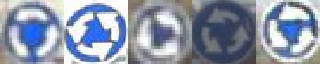

there are 4689 examples for "3.27" class. Here some of them:


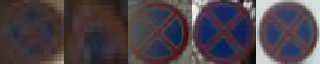

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.53759765625


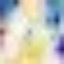

there are 30338 examples for "5.19" class. Here some of them:


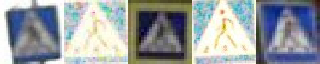

there are 3435 examples for "5.20" class. Here some of them:


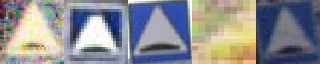

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.25, prediction=other, score=0.537109375


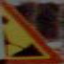

there are 1048 examples for "1.25" class. Here some of them:


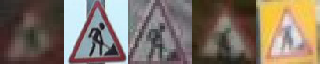

there are 133191 examples for "other" class. Here some of them:


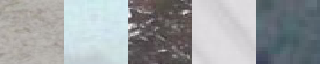

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=other, score=0.53515625


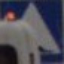

there are 3435 examples for "5.20" class. Here some of them:


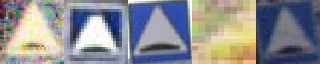

there are 133191 examples for "other" class. Here some of them:


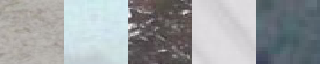

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=other, score=0.53369140625


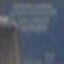

there are 851 examples for "6.9" class. Here some of them:


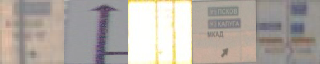

there are 133191 examples for "other" class. Here some of them:


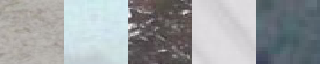

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=5.19, score=0.53125


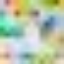

there are 416 examples for "4.4" class. Here some of them:


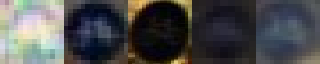

there are 30338 examples for "5.19" class. Here some of them:


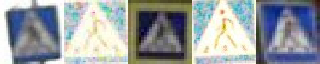

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.6, prediction=5.14, score=0.53076171875


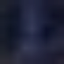

there are 925 examples for "6.6" class. Here some of them:


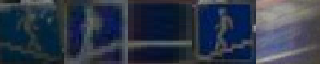

there are 433 examples for "5.14" class. Here some of them:


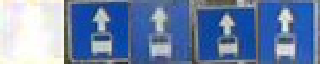

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.5302734375


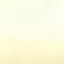

there are 30338 examples for "5.19" class. Here some of them:


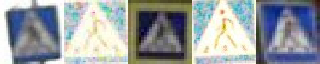

there are 133191 examples for "other" class. Here some of them:


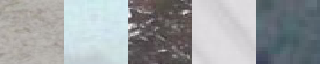

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=5.16, score=0.529296875


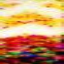

there are 689 examples for "8.22" class. Here some of them:


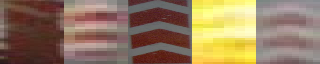

there are 6247 examples for "5.16" class. Here some of them:


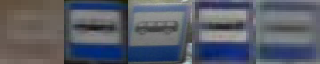

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=8.2, score=0.52880859375


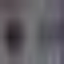

there are 1069 examples for "6.10" class. Here some of them:


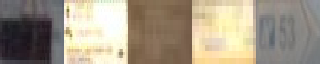

there are 2135 examples for "8.2" class. Here some of them:


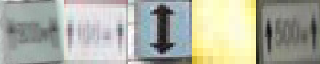

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.24, prediction=8.5, score=0.52880859375


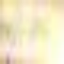

there are 335 examples for "8.24" class. Here some of them:


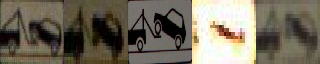

there are 303 examples for "8.5" class. Here some of them:


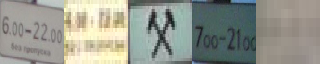

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.5263671875


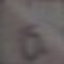

there are 61 examples for "8.17" class. Here some of them:


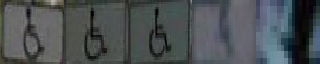

there are 133191 examples for "other" class. Here some of them:


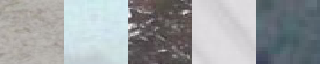

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=5.19, score=0.52587890625


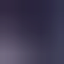

there are 6247 examples for "5.16" class. Here some of them:


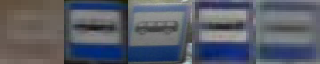

there are 30338 examples for "5.19" class. Here some of them:


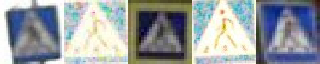

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.52490234375


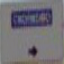

there are 1069 examples for "6.10" class. Here some of them:


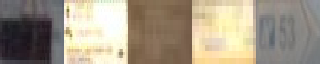

there are 851 examples for "6.9" class. Here some of them:


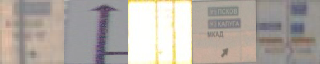

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=6.10, score=0.52294921875


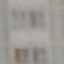

there are 133191 examples for "other" class. Here some of them:


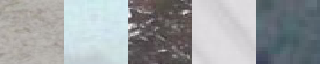

there are 1069 examples for "6.10" class. Here some of them:


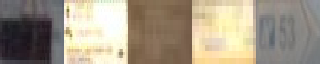

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=6.4, score=0.51806640625


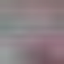

there are 5333 examples for "2.4" class. Here some of them:


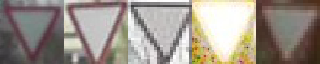

there are 1423 examples for "6.4" class. Here some of them:


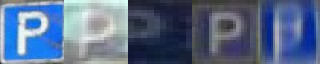

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.517578125


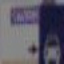

there are 1069 examples for "6.10" class. Here some of them:


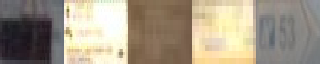

there are 851 examples for "6.9" class. Here some of them:


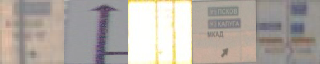

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.5166015625


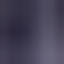

there are 30338 examples for "5.19" class. Here some of them:


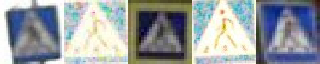

there are 3435 examples for "5.20" class. Here some of them:


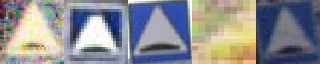

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=6.10, score=0.515625


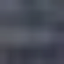

there are 6247 examples for "5.16" class. Here some of them:


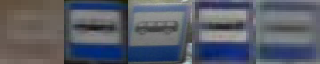

there are 1069 examples for "6.10" class. Here some of them:


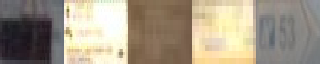

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.14, score=0.5146484375


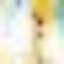

there are 30338 examples for "5.19" class. Here some of them:


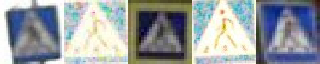

there are 433 examples for "5.14" class. Here some of them:


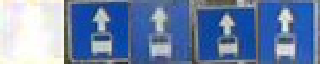

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.6, score=0.51025390625


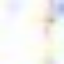

there are 30338 examples for "5.19" class. Here some of them:


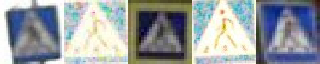

there are 677 examples for "5.6" class. Here some of them:


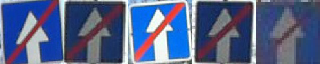

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=3.27, score=0.50927734375


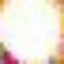

there are 225 examples for "4.3" class. Here some of them:


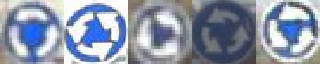

there are 4689 examples for "3.27" class. Here some of them:


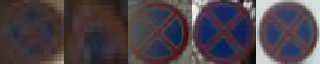

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=other, score=0.50732421875


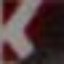

there are 559 examples for "1.34" class. Here some of them:


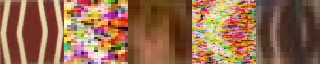

there are 133191 examples for "other" class. Here some of them:


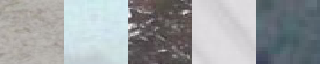

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.17, prediction=1.13, score=0.5068359375


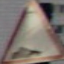

there are 1648 examples for "1.17" class. Here some of them:


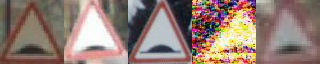

there are 78 examples for "1.13" class. Here some of them:


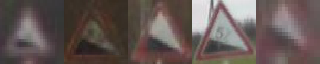

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.1, prediction=8.22, score=0.5048828125


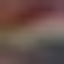

there are 1900 examples for "3.1" class. Here some of them:


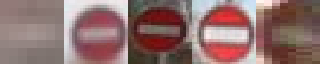

there are 689 examples for "8.22" class. Here some of them:


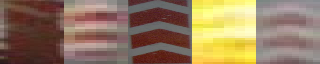

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=other, score=0.5048828125


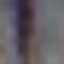

there are 61 examples for "8.17" class. Here some of them:


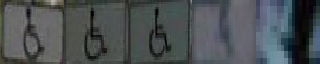

there are 133191 examples for "other" class. Here some of them:


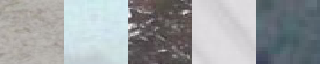

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=4.1, score=0.50439453125


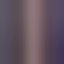

there are 6247 examples for "5.16" class. Here some of them:


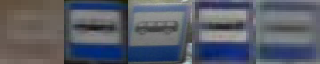

there are 5770 examples for "4.1" class. Here some of them:


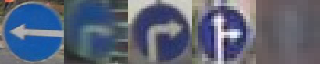

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=5.15, score=0.50439453125


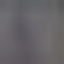

there are 61 examples for "8.17" class. Here some of them:


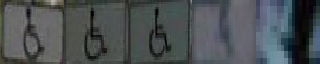

there are 12199 examples for "5.15" class. Here some of them:


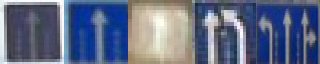

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.9, score=0.50390625


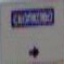

there are 1069 examples for "6.10" class. Here some of them:


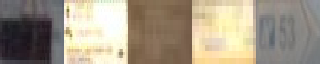

there are 851 examples for "6.9" class. Here some of them:


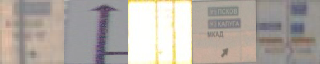

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.50146484375


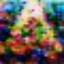

there are 30338 examples for "5.19" class. Here some of them:


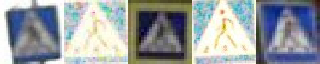

there are 3435 examples for "5.20" class. Here some of them:


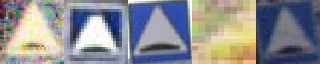

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=6.9, score=0.5009765625


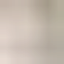

there are 30338 examples for "5.19" class. Here some of them:


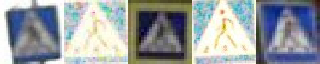

there are 851 examples for "6.9" class. Here some of them:


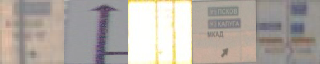

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.498046875


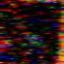

there are 30338 examples for "5.19" class. Here some of them:


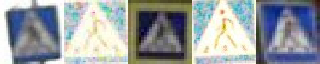

there are 133191 examples for "other" class. Here some of them:


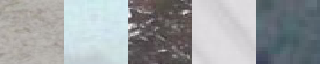

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.4, prediction=5.3, score=0.49462890625


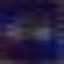

there are 50 examples for "5.4" class. Here some of them:


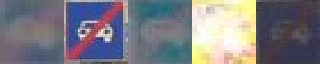

there are 133 examples for "5.3" class. Here some of them:


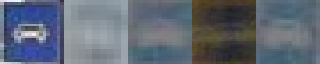

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.4921875


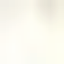

there are 30338 examples for "5.19" class. Here some of them:


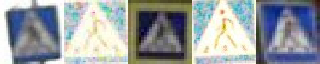

there are 133191 examples for "other" class. Here some of them:


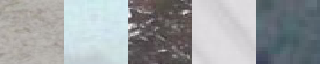

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=4.4, score=0.491943359375


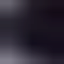

there are 5770 examples for "4.1" class. Here some of them:


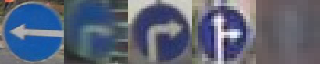

there are 416 examples for "4.4" class. Here some of them:


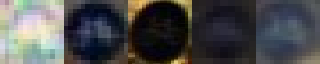

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.490966796875


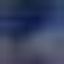

there are 30338 examples for "5.19" class. Here some of them:


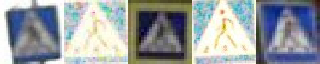

there are 3435 examples for "5.20" class. Here some of them:


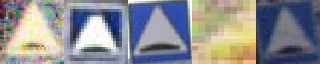

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=other, score=0.490966796875


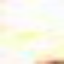

there are 689 examples for "8.22" class. Here some of them:


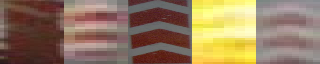

there are 133191 examples for "other" class. Here some of them:


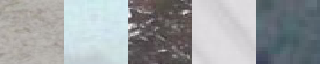

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=8.24, score=0.486572265625


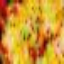

there are 133191 examples for "other" class. Here some of them:


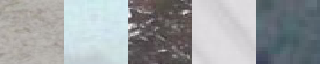

there are 335 examples for "8.24" class. Here some of them:


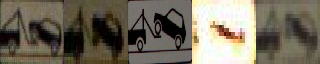

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=other, score=0.484375


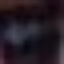

there are 403 examples for "5.7" class. Here some of them:


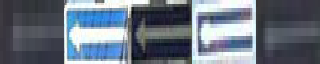

there are 133191 examples for "other" class. Here some of them:


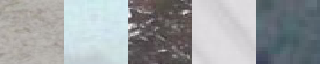

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=other, score=0.48291015625


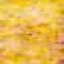

there are 303 examples for "8.5" class. Here some of them:


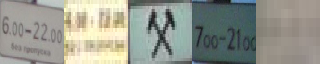

there are 133191 examples for "other" class. Here some of them:


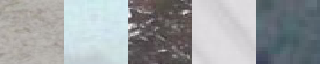

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.3, score=0.479736328125


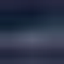

there are 30338 examples for "5.19" class. Here some of them:


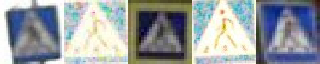

there are 133 examples for "5.3" class. Here some of them:


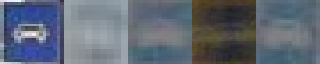

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.47802734375


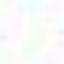

there are 30338 examples for "5.19" class. Here some of them:


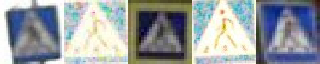

there are 133191 examples for "other" class. Here some of them:


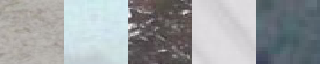

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.24, prediction=6.10, score=0.47802734375


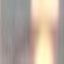

there are 143 examples for "5.24" class. Here some of them:


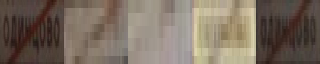

there are 1069 examples for "6.10" class. Here some of them:


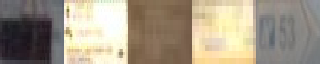

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.23, prediction=5.15, score=0.475341796875


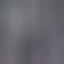

there are 319 examples for "8.23" class. Here some of them:


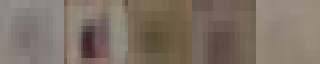

there are 12199 examples for "5.15" class. Here some of them:


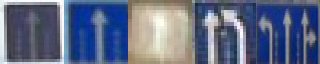

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.10, score=0.474853515625


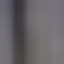

there are 61 examples for "8.17" class. Here some of them:


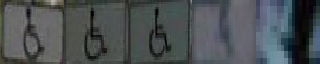

there are 1069 examples for "6.10" class. Here some of them:


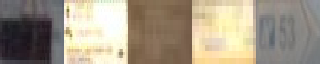

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=5.19, score=0.47412109375


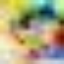

there are 5770 examples for "4.1" class. Here some of them:


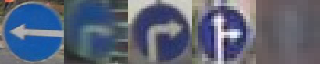

there are 30338 examples for "5.19" class. Here some of them:


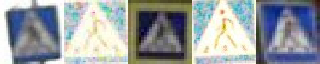

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.6, prediction=4.1, score=0.47412109375


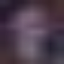

there are 677 examples for "5.6" class. Here some of them:


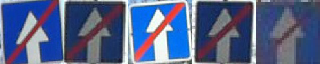

there are 5770 examples for "4.1" class. Here some of them:


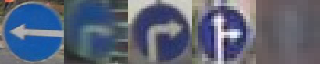

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=6.4, score=0.471923828125


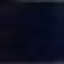

there are 1144 examples for "5.5" class. Here some of them:


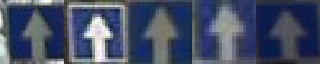

there are 1423 examples for "6.4" class. Here some of them:


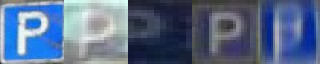

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.24, prediction=4.1, score=0.471923828125


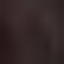

there are 335 examples for "8.24" class. Here some of them:


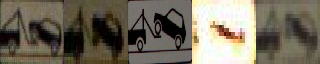

there are 5770 examples for "4.1" class. Here some of them:


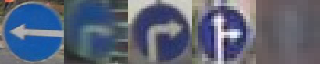

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=5.14, score=0.471435546875


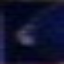

there are 133 examples for "5.3" class. Here some of them:


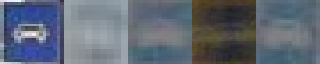

there are 433 examples for "5.14" class. Here some of them:


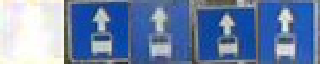

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=8.6, score=0.471435546875


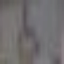

there are 61 examples for "8.17" class. Here some of them:


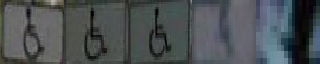

there are 130 examples for "8.6" class. Here some of them:


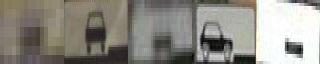

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.9, score=0.46923828125


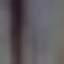

there are 61 examples for "8.17" class. Here some of them:


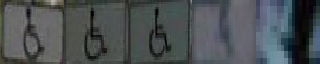

there are 851 examples for "6.9" class. Here some of them:


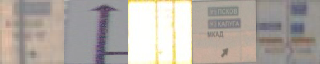

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=other, score=0.468505859375


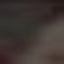

there are 5333 examples for "2.4" class. Here some of them:


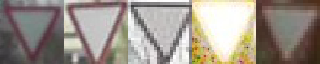

there are 133191 examples for "other" class. Here some of them:


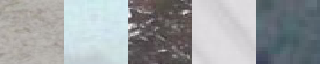

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=4.1, score=0.468505859375


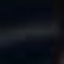

there are 403 examples for "5.7" class. Here some of them:


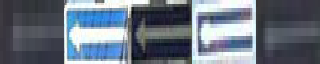

there are 5770 examples for "4.1" class. Here some of them:


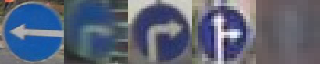

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.27, prediction=3.28, score=0.46630859375


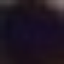

there are 4689 examples for "3.27" class. Here some of them:


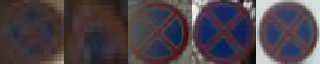

there are 373 examples for "3.28" class. Here some of them:


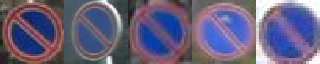

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.3, prediction=3.27, score=0.4638671875


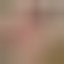

there are 39 examples for "3.3" class. Here some of them:


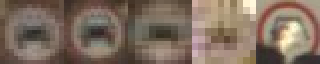

there are 4689 examples for "3.27" class. Here some of them:


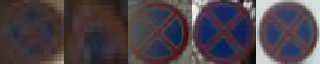

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=5.19, score=0.462890625


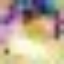

there are 5770 examples for "4.1" class. Here some of them:


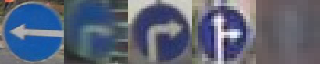

there are 30338 examples for "5.19" class. Here some of them:


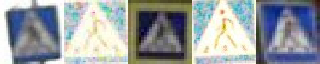

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=8.2, score=0.46044921875


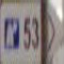

there are 1069 examples for "6.10" class. Here some of them:


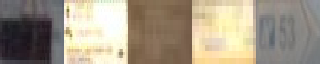

there are 2135 examples for "8.2" class. Here some of them:


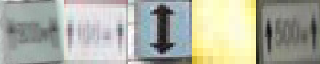

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.459228515625


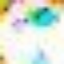

there are 3847 examples for "4.2" class. Here some of them:


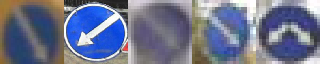

there are 416 examples for "4.4" class. Here some of them:


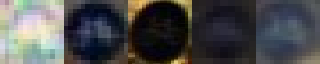

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.20, prediction=1.22, score=0.456298828125


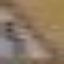

there are 615 examples for "1.20" class. Here some of them:


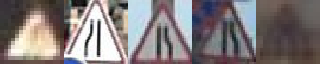

there are 928 examples for "1.22" class. Here some of them:


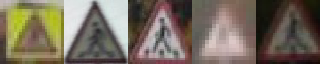

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.22, prediction=5.16, score=0.45458984375


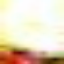

there are 689 examples for "8.22" class. Here some of them:


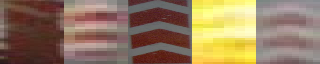

there are 6247 examples for "5.16" class. Here some of them:


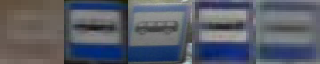

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.1, prediction=other, score=0.451171875


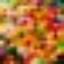

there are 12902 examples for "2.1" class. Here some of them:


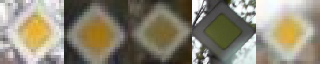

there are 133191 examples for "other" class. Here some of them:


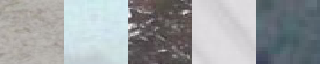

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=6.16, score=0.44873046875


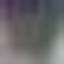

there are 5333 examples for "2.4" class. Here some of them:


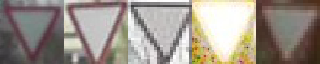

there are 1384 examples for "6.16" class. Here some of them:


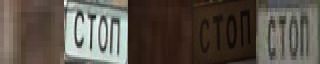

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.15, score=0.4482421875


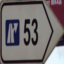

there are 1069 examples for "6.10" class. Here some of them:


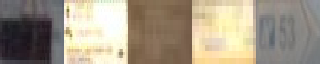

there are 12199 examples for "5.15" class. Here some of them:


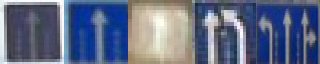

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.4453125


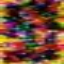

there are 30338 examples for "5.19" class. Here some of them:


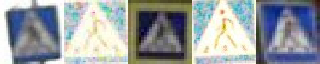

there are 133191 examples for "other" class. Here some of them:


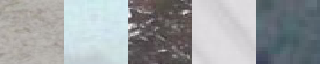

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=8.1, score=0.444091796875


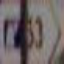

there are 1069 examples for "6.10" class. Here some of them:


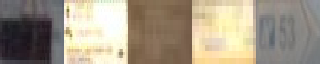

there are 362 examples for "8.1" class. Here some of them:


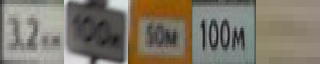

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=4.1, score=0.443603515625


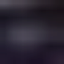

there are 403 examples for "5.7" class. Here some of them:


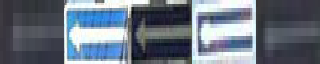

there are 5770 examples for "4.1" class. Here some of them:


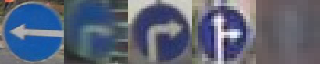

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=other, score=0.442138671875


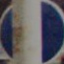

there are 5770 examples for "4.1" class. Here some of them:


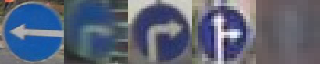

there are 133191 examples for "other" class. Here some of them:


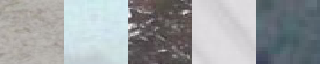

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=8.2, score=0.440673828125


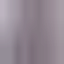

there are 5770 examples for "4.1" class. Here some of them:


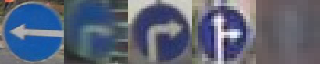

there are 2135 examples for "8.2" class. Here some of them:


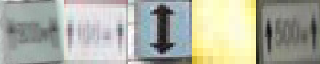

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=8.2, score=0.440185546875


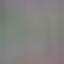

there are 1069 examples for "6.10" class. Here some of them:


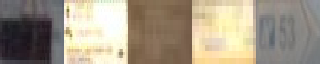

there are 2135 examples for "8.2" class. Here some of them:


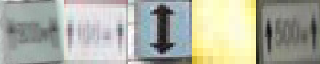

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=4.1, score=0.439453125


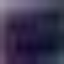

there are 403 examples for "5.7" class. Here some of them:


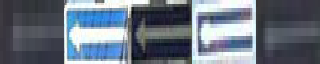

there are 5770 examples for "4.1" class. Here some of them:


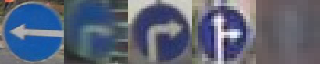

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=6.4, score=0.4375


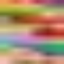

there are 30338 examples for "5.19" class. Here some of them:


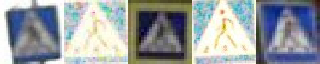

there are 1423 examples for "6.4" class. Here some of them:


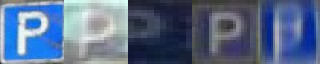

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=1.34, score=0.435791015625


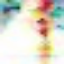

there are 30338 examples for "5.19" class. Here some of them:


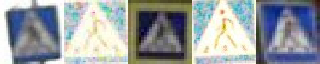

there are 559 examples for "1.34" class. Here some of them:


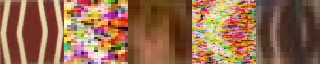

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=5.7, score=0.433837890625


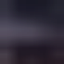

there are 133 examples for "5.3" class. Here some of them:


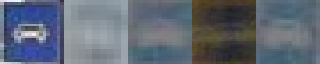

there are 403 examples for "5.7" class. Here some of them:


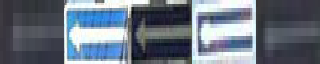

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=other, score=0.4306640625


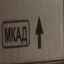

there are 851 examples for "6.9" class. Here some of them:


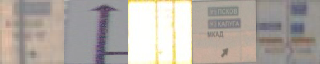

there are 133191 examples for "other" class. Here some of them:


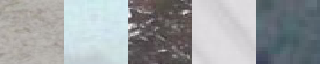

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=7.3, prediction=5.20, score=0.4287109375


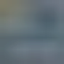

there are 1115 examples for "7.3" class. Here some of them:


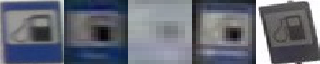

there are 3435 examples for "5.20" class. Here some of them:


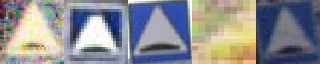

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.34, prediction=5.16, score=0.422119140625


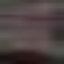

there are 559 examples for "1.34" class. Here some of them:


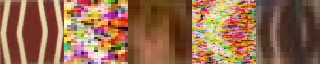

there are 6247 examples for "5.16" class. Here some of them:


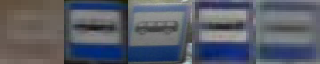

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.421142578125


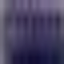

there are 403 examples for "5.7" class. Here some of them:


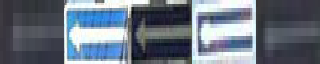

there are 1069 examples for "6.10" class. Here some of them:


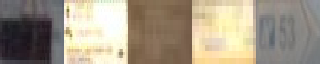

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=5.24, score=0.420654296875


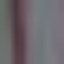

there are 61 examples for "8.17" class. Here some of them:


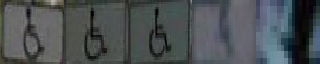

there are 143 examples for "5.24" class. Here some of them:


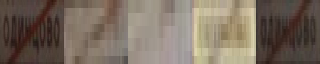

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.20, prediction=1.11, score=0.419677734375


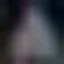

there are 3435 examples for "5.20" class. Here some of them:


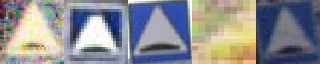

there are 1021 examples for "1.11" class. Here some of them:


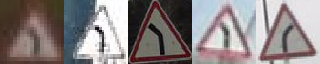

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.11, score=0.417236328125


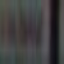

there are 1069 examples for "6.10" class. Here some of them:


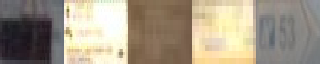

there are 37 examples for "6.11" class. Here some of them:


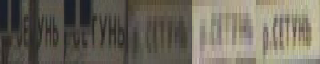

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.16, score=0.412353515625


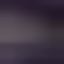

there are 30338 examples for "5.19" class. Here some of them:


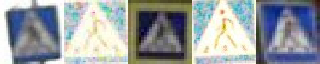

there are 6247 examples for "5.16" class. Here some of them:


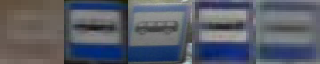

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=5.19, score=0.4111328125


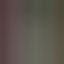

there are 5333 examples for "2.4" class. Here some of them:


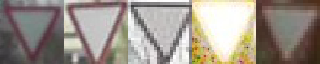

there are 30338 examples for "5.19" class. Here some of them:


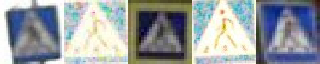

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.16, prediction=6.4, score=0.41015625


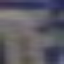

there are 6247 examples for "5.16" class. Here some of them:


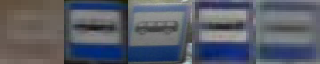

there are 1423 examples for "6.4" class. Here some of them:


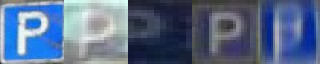

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.23, score=0.41015625


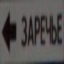

there are 1069 examples for "6.10" class. Here some of them:


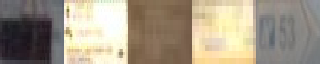

there are 144 examples for "5.23" class. Here some of them:


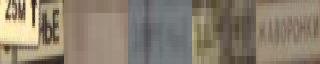

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.13, prediction=4.2, score=0.409912109375


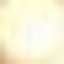

there are 368 examples for "3.13" class. Here some of them:


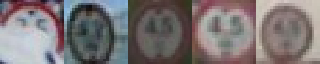

there are 3847 examples for "4.2" class. Here some of them:


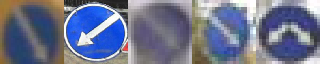

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=4.4, score=0.406982421875


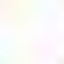

there are 30338 examples for "5.19" class. Here some of them:


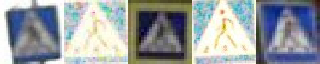

there are 416 examples for "4.4" class. Here some of them:


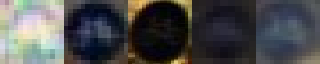

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.4, score=0.405029296875


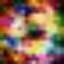

there are 225 examples for "4.3" class. Here some of them:


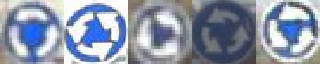

there are 416 examples for "4.4" class. Here some of them:


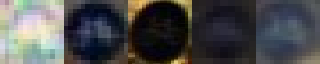

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=4.4, score=0.400390625


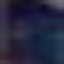

there are 133 examples for "5.3" class. Here some of them:


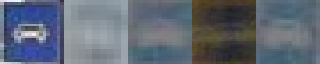

there are 416 examples for "4.4" class. Here some of them:


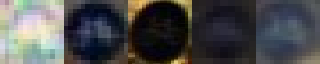

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.2, prediction=3.1, score=0.397705078125


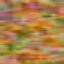

there are 185 examples for "3.2" class. Here some of them:


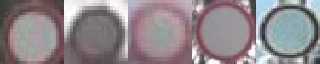

there are 1900 examples for "3.1" class. Here some of them:


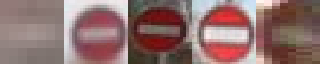

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=5.19, score=0.3974609375


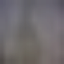

there are 61 examples for "8.17" class. Here some of them:


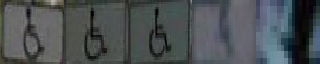

there are 30338 examples for "5.19" class. Here some of them:


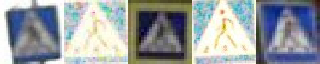

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.23, score=0.3935546875


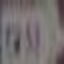

there are 1069 examples for "6.10" class. Here some of them:


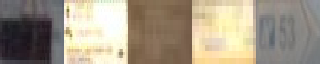

there are 144 examples for "5.23" class. Here some of them:


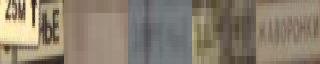

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.1, prediction=1.11, score=0.38525390625


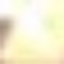

there are 208 examples for "1.1" class. Here some of them:


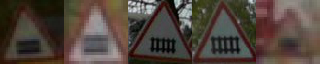

there are 1021 examples for "1.11" class. Here some of them:


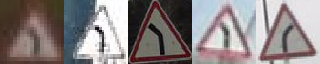

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=6.10, score=0.385009765625


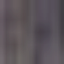

there are 1384 examples for "6.16" class. Here some of them:


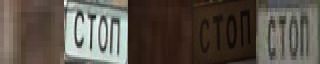

there are 1069 examples for "6.10" class. Here some of them:


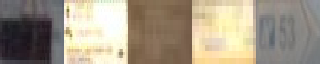

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=8.24, score=0.382568359375


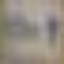

there are 2135 examples for "8.2" class. Here some of them:


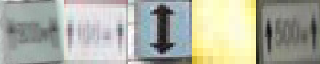

there are 335 examples for "8.24" class. Here some of them:


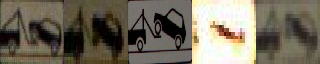

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=5.23, score=0.378173828125


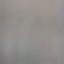

there are 303 examples for "8.5" class. Here some of them:


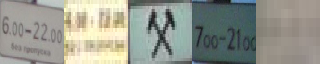

there are 144 examples for "5.23" class. Here some of them:


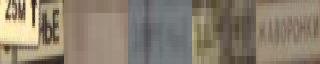

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=4.4, score=0.375


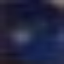

there are 133 examples for "5.3" class. Here some of them:


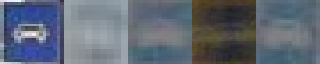

there are 416 examples for "4.4" class. Here some of them:


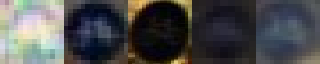

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.373291015625


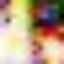

there are 30338 examples for "5.19" class. Here some of them:


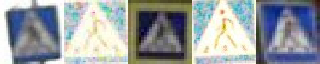

there are 133191 examples for "other" class. Here some of them:


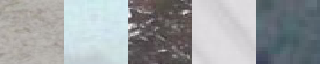

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.2, prediction=4.4, score=0.37109375


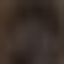

there are 3847 examples for "4.2" class. Here some of them:


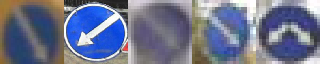

there are 416 examples for "4.4" class. Here some of them:


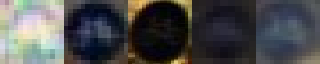

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.15, prediction=other, score=0.363525390625


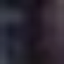

there are 12199 examples for "5.15" class. Here some of them:


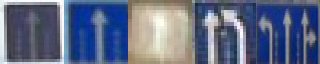

there are 133191 examples for "other" class. Here some of them:


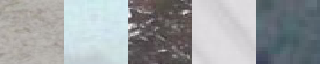

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=4.2, score=0.363037109375


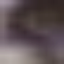

there are 5333 examples for "2.4" class. Here some of them:


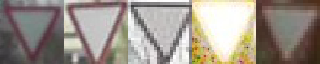

there are 3847 examples for "4.2" class. Here some of them:


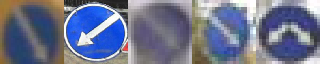

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=4.1, score=0.3603515625


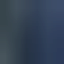

there are 30338 examples for "5.19" class. Here some of them:


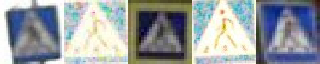

there are 5770 examples for "4.1" class. Here some of them:


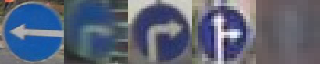

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.5, prediction=8, score=0.352783203125


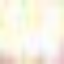

there are 303 examples for "8.5" class. Here some of them:


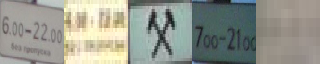

there are 98 examples for "8" class. Here some of them:


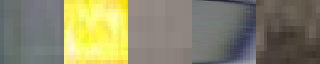

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=5.15, score=0.35205078125


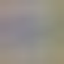

there are 2135 examples for "8.2" class. Here some of them:


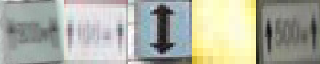

there are 12199 examples for "5.15" class. Here some of them:


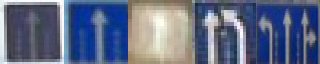

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.4, prediction=3.28, score=0.34619140625


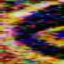

there are 416 examples for "4.4" class. Here some of them:


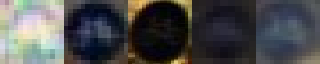

there are 373 examples for "3.28" class. Here some of them:


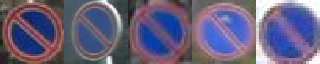

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=other, score=0.345458984375


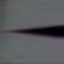

there are 1069 examples for "6.10" class. Here some of them:


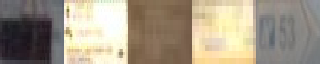

there are 133191 examples for "other" class. Here some of them:


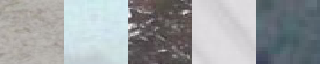

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=8.2, score=0.334716796875


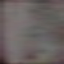

there are 61 examples for "8.17" class. Here some of them:


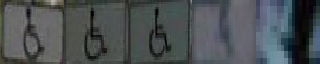

there are 2135 examples for "8.2" class. Here some of them:


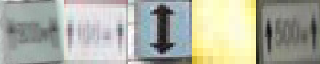

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=4.2, score=0.333984375


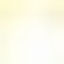

there are 133191 examples for "other" class. Here some of them:


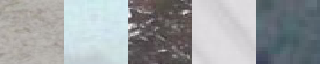

there are 3847 examples for "4.2" class. Here some of them:


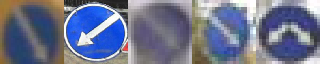

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.14, score=0.33056640625


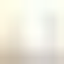

there are 30338 examples for "5.19" class. Here some of them:


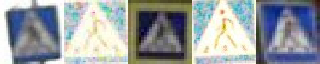

there are 433 examples for "5.14" class. Here some of them:


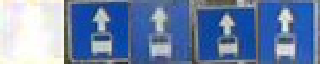

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=6.10, score=0.32958984375


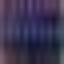

there are 403 examples for "5.7" class. Here some of them:


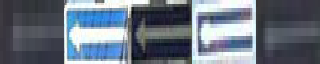

there are 1069 examples for "6.10" class. Here some of them:


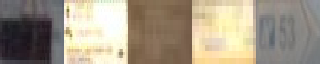

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.15, score=0.328369140625


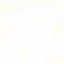

there are 30338 examples for "5.19" class. Here some of them:


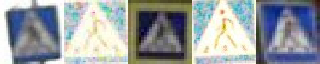

there are 12199 examples for "5.15" class. Here some of them:


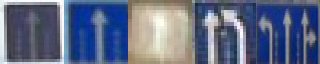

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=3.27, score=0.327880859375


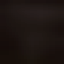

there are 5333 examples for "2.4" class. Here some of them:


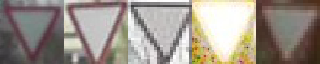

there are 4689 examples for "3.27" class. Here some of them:


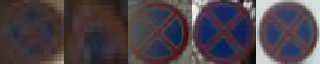

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.24, prediction=5.19, score=0.327392578125


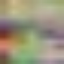

there are 335 examples for "8.24" class. Here some of them:


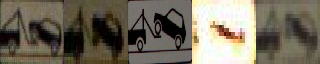

there are 30338 examples for "5.19" class. Here some of them:


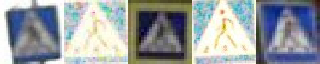

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8, prediction=other, score=0.325439453125


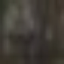

there are 98 examples for "8" class. Here some of them:


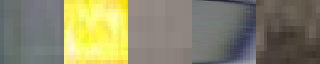

there are 133191 examples for "other" class. Here some of them:


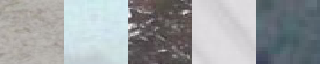

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.9, prediction=6.10, score=0.324951171875


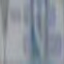

there are 851 examples for "6.9" class. Here some of them:


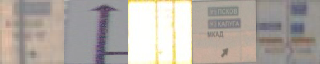

there are 1069 examples for "6.10" class. Here some of them:


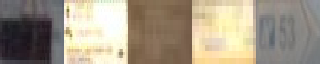

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.15, score=0.32421875


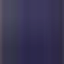

there are 30338 examples for "5.19" class. Here some of them:


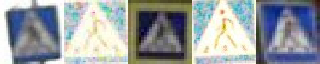

there are 12199 examples for "5.15" class. Here some of them:


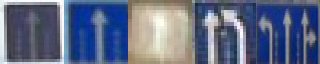

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.16, prediction=8.2, score=0.320556640625


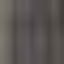

there are 1384 examples for "6.16" class. Here some of them:


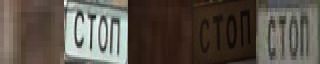

there are 2135 examples for "8.2" class. Here some of them:


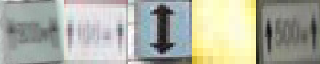

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.1, prediction=8.22, score=0.31982421875


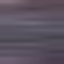

there are 5770 examples for "4.1" class. Here some of them:


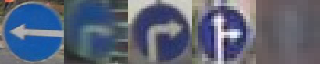

there are 689 examples for "8.22" class. Here some of them:


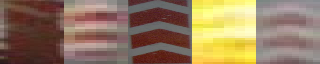

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.14, prediction=5.15, score=0.315185546875


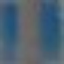

there are 433 examples for "5.14" class. Here some of them:


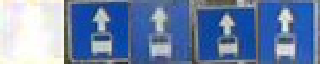

there are 12199 examples for "5.15" class. Here some of them:


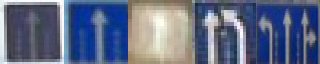

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=4.1, score=0.3115234375


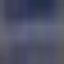

there are 403 examples for "5.7" class. Here some of them:


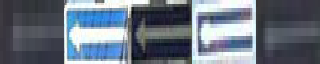

there are 5770 examples for "4.1" class. Here some of them:


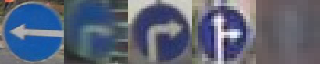

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=6.11, score=0.308349609375


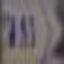

there are 1069 examples for "6.10" class. Here some of them:


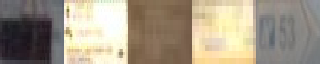

there are 37 examples for "6.11" class. Here some of them:


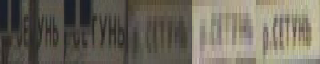

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.27, prediction=4.1, score=0.3046875


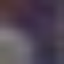

there are 4689 examples for "3.27" class. Here some of them:


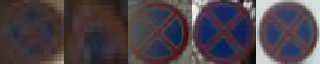

there are 5770 examples for "4.1" class. Here some of them:


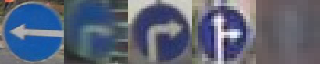

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=3.27, score=0.30224609375


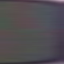

there are 61 examples for "8.17" class. Here some of them:


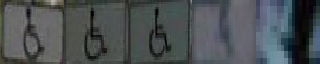

there are 4689 examples for "3.27" class. Here some of them:


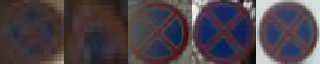

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.5, prediction=5.6, score=0.302001953125


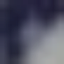

there are 1144 examples for "5.5" class. Here some of them:


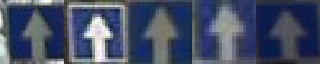

there are 677 examples for "5.6" class. Here some of them:


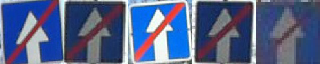

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8, prediction=other, score=0.300537109375


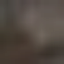

there are 98 examples for "8" class. Here some of them:


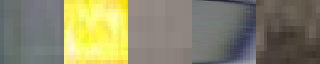

there are 133191 examples for "other" class. Here some of them:


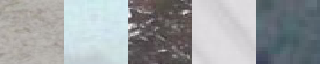

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=6.10, prediction=5.16, score=0.29931640625


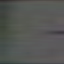

there are 1069 examples for "6.10" class. Here some of them:


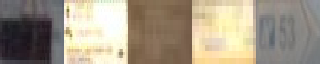

there are 6247 examples for "5.16" class. Here some of them:


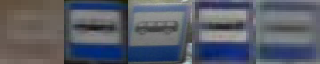

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.11, prediction=2.3, score=0.296142578125


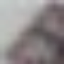

there are 1021 examples for "1.11" class. Here some of them:


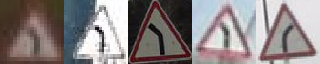

there are 1996 examples for "2.3" class. Here some of them:


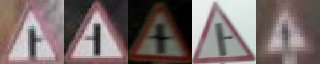

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=6.4, score=0.295166015625


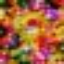

there are 133191 examples for "other" class. Here some of them:


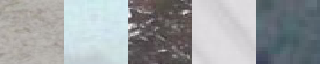

there are 1423 examples for "6.4" class. Here some of them:


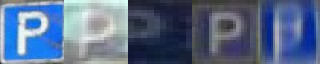

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=5.20, score=0.294921875


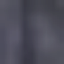

there are 30338 examples for "5.19" class. Here some of them:


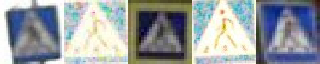

there are 3435 examples for "5.20" class. Here some of them:


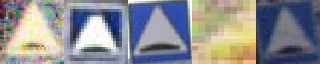

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=other, score=0.293212890625


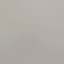

there are 30338 examples for "5.19" class. Here some of them:


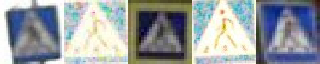

there are 133191 examples for "other" class. Here some of them:


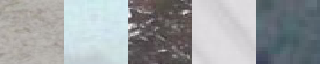

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=4.2, score=0.286865234375


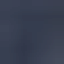

there are 30338 examples for "5.19" class. Here some of them:


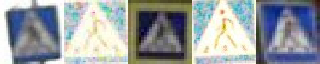

there are 3847 examples for "4.2" class. Here some of them:


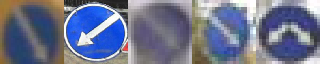

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.24, prediction=other, score=0.286865234375


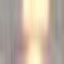

there are 143 examples for "5.24" class. Here some of them:


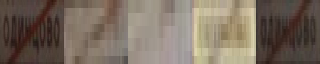

there are 133191 examples for "other" class. Here some of them:


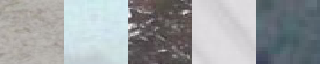

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.7, prediction=5.15, score=0.27880859375


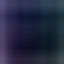

there are 403 examples for "5.7" class. Here some of them:


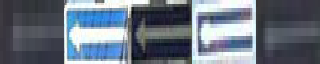

there are 12199 examples for "5.15" class. Here some of them:


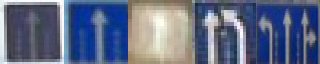

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.4, score=0.2724609375


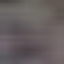

there are 61 examples for "8.17" class. Here some of them:


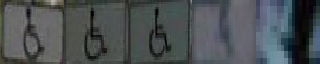

there are 1423 examples for "6.4" class. Here some of them:


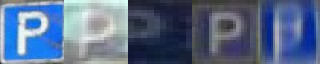

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.19, prediction=3.10, score=0.269287109375


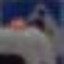

there are 30338 examples for "5.19" class. Here some of them:


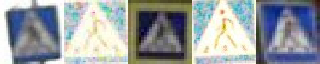

there are 95 examples for "3.10" class. Here some of them:


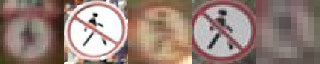

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=6.9, score=0.2646484375


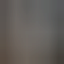

there are 5333 examples for "2.4" class. Here some of them:


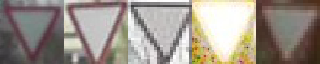

there are 851 examples for "6.9" class. Here some of them:


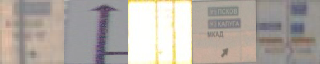

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.2, prediction=5.14, score=0.261474609375


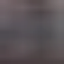

there are 2135 examples for "8.2" class. Here some of them:


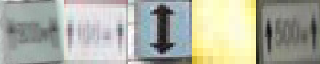

there are 433 examples for "5.14" class. Here some of them:


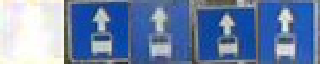

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.10, prediction=1.25, score=0.253662109375


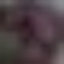

there are 95 examples for "3.10" class. Here some of them:


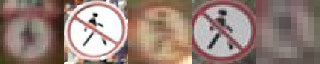

there are 1048 examples for "1.25" class. Here some of them:


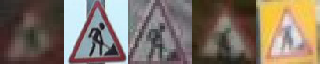

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=5.3, prediction=3.27, score=0.253173828125


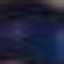

there are 133 examples for "5.3" class. Here some of them:


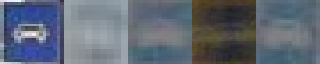

there are 4689 examples for "3.27" class. Here some of them:


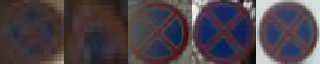

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=4.3, prediction=4.4, score=0.249267578125


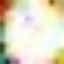

there are 225 examples for "4.3" class. Here some of them:


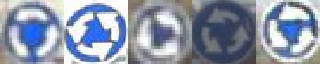

there are 416 examples for "4.4" class. Here some of them:


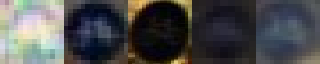

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=3.24, prediction=4.3, score=0.2454833984375


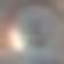

there are 5646 examples for "3.24" class. Here some of them:


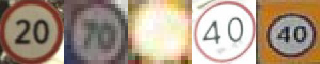

there are 225 examples for "4.3" class. Here some of them:


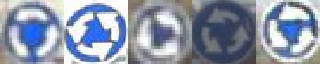

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.7, prediction=8.2, score=0.2327880859375


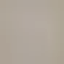

there are 7 examples for "8.7" class. Here some of them:


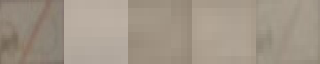

there are 2135 examples for "8.2" class. Here some of them:


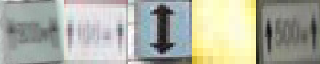

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=3.24, score=0.2119140625


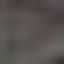

there are 5333 examples for "2.4" class. Here some of them:


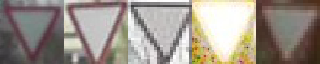

there are 5646 examples for "3.24" class. Here some of them:


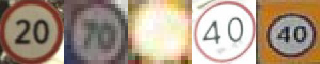

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=1.25, prediction=1.15, score=0.202392578125


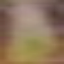

there are 1048 examples for "1.25" class. Here some of them:


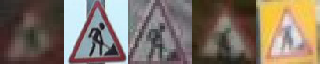

there are 264 examples for "1.15" class. Here some of them:


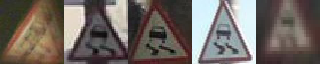

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.13, prediction=8.2, score=0.200439453125


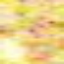

there are 987 examples for "8.13" class. Here some of them:


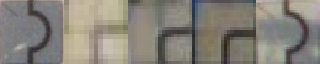

there are 2135 examples for "8.2" class. Here some of them:


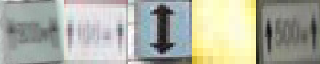

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=8.17, prediction=6.16, score=0.1702880859375


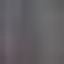

there are 61 examples for "8.17" class. Here some of them:


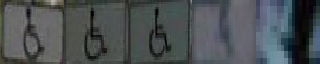

there are 1384 examples for "6.16" class. Here some of them:


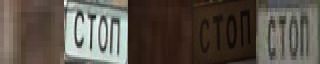

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=2.4, prediction=5.19, score=0.16748046875


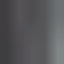

there are 5333 examples for "2.4" class. Here some of them:


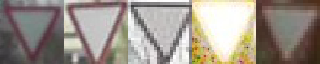

there are 30338 examples for "5.19" class. Here some of them:


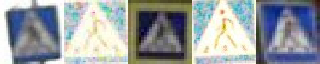

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
true_label=other, prediction=5.15, score=0.16650390625


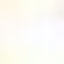

there are 133191 examples for "other" class. Here some of them:


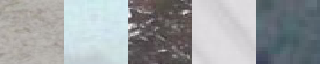

there are 12199 examples for "5.15" class. Here some of them:


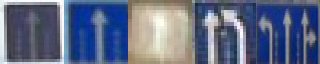

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


In [6]:
for error in sorted(errors, key=lambda x: -x['score']):
    print('true_label='+error['true_label']+', prediction='+error['prediction']+', score={}'.format(error['score']))
    display(error['image'])
    examples, count = get_label_examples(error['true_label'])
    print('there are {} examples for "{}" class. Here some of them:'.format(count, error['true_label']))
    display(examples)
    examples, count = get_label_examples(error['prediction'])
    print('there are {} examples for "{}" class. Here some of them:'.format(count, error['prediction']))
    display(examples)
    print('-'*120)
    print('-'*120)    
    print('-'*120)    